In [ ]:
from google.colab import drive
drive.mount('/content/drive')          #

Mounted at /content/drive


In [ ]:
%cd /content/drive/My\ Drive/Bacterial_pneumonia


/content/drive/My Drive/Bacterial_pneumonia


In [ ]:
import tensorflow as tf                                             
import numpy as np                                                  
import argparse
import cv2
import os
import pandas as pd                                                  
import matplotlib.pyplot as plt

from PIL import Image
from glob import glob
from tensorflow.keras.preprocessing import image_dataset_from_directory
from keras.preprocessing import image
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import AveragePooling2D, Dropout,Flatten, Dense
from keras.models import *
from keras.applications.resnet50 import ResNet50
from keras.applications.resnet50 import preprocess_input
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix


In [ ]:
image_size = [224, 224]

train = 'train'
valid = 'test'

In [ ]:
res = ResNet50(
    input_shape=image_size + [3],
    weights='imagenet', #0-1
    include_top=False)

94773248/94765736 [==============================] - 2s 0us/step


In [ ]:
folders = glob('train/*')
len(folders)


2

In [ ]:
#headModel = res.output
#headModel = AveragePooling2D(pool_size=(4, 4))(headModel)#pool_size=(4, 4)
#headModel = Flatten(name="flatten")(headModel)
#headModel = Dense(256, activation="relu")(headModel)
#headModel = Dropout(0.5)(headModel)
#headModel = Dense(2, activation="softmax")(headModel)

In [ ]:
pooling=AveragePooling2D(pool_size=(4,4))(res.output)   
flat = Flatten()(pooling)
dense1=Dense(64, activation='relu')(flat)
dense2=Dense(32, activation='relu')(dense1)
dropout2=Dropout(0.5)(dense2)
dense2=Dense(2,activation='softmax')(dropout2)

model=Model(inputs=res.input,outputs=dense2)

In [ ]:
for layer in res.layers:
    layer.trainable = False

In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
conv1_bn (BatchNormalization)   (None, 112, 112, 64) 256         conv1_conv[0][0]                 
______________________________________________________________________________________________

In [ ]:
len(model.layers)

181

In [ ]:
#for layer in res.layers[159:]:
    #layer.trainable=True
#for layer in res.layers[0:159]:           #unfreezing res layers 159 to last layer
 # layer.trainable = False

In [ ]:
model.compile(
  loss='categorical_crossentropy',
  optimizer=Adam(learning_rate=0.001),
  metrics=['accuracy']
)

In [ ]:
train_datagen = ImageDataGenerator(rescale = 1./255,
                                   shear_range = 0.05,
                                   zoom_range = 0.05,
                                   width_shift_range=0.1,
                                   height_shift_range=0.1,
                                   horizontal_flip = True,
                                   rotation_range=15,
                                   fill_mode="nearest")

test_datagen = ImageDataGenerator(rescale = 1./255)

In [ ]:

training_set = train_datagen.flow_from_directory(train,
                                                 target_size = (224, 224),
                                                 batch_size = 32,
                                                 class_mode='categorical')
training_set.class_indices


Found 2000 images belonging to 2 classes.


{'BACTERIA': 0, 'NORMAL': 1}

In [ ]:
test_set = test_datagen.flow_from_directory(valid,
                                            target_size = (224, 224),
                                            batch_size = 32,
                                            class_mode='categorical')
test_set.class_indices

Found 762 images belonging to 2 classes.


{'BACTERIA': 0, 'NORMAL': 1}

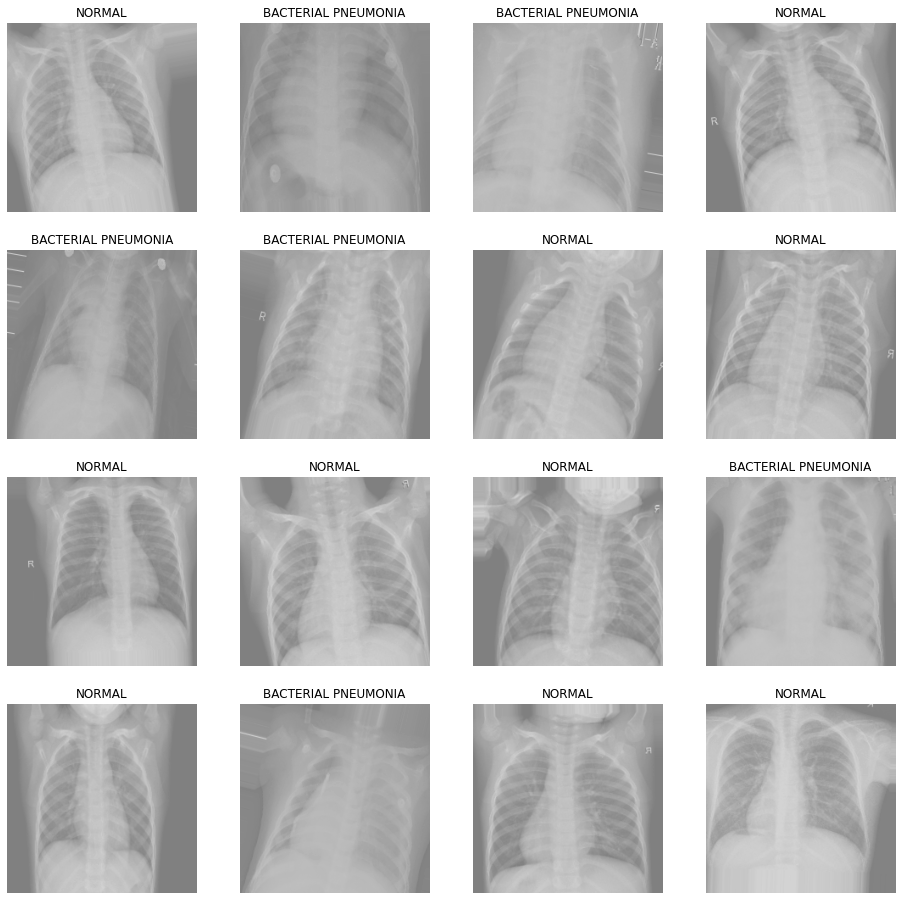

In [ ]:
all_labels = ['BACTERIAL PNEUMONIA','NORMAL']
t_x, t_y = next(training_set)
fig, m_axs = plt.subplots(4, 4, figsize = (16, 16))
for (c_x, c_y, c_ax) in zip(t_x, t_y, m_axs.flatten()):
    c_ax.imshow(c_x[:,:,0], cmap= 'gray', vmin = -1.5, vmax = 1.5)
    c_ax.set_title(', '.join([n_class for n_class, n_score in zip(all_labels, c_y) 
                             if n_score>0.5]))
    c_ax.axis('off')

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='loss', factor=0.2,
                              patience=5, verbose=1, cooldown=3, mode='auto', min_delta=0.01)

In [ ]:
history = model.fit(
  training_set,
  validation_data=test_set,
  epochs=60,
  steps_per_epoch=63,     # len(train)//batchsize
  validation_steps=24,
  callbacks=[reduce_lr]
  
)

Epoch 1/60
63/63 [==============================] - 1550s 24s/step - loss: 0.7004 - accuracy: 0.5285 - val_loss: 0.6685 - val_accuracy: 0.8478
Epoch 2/60
63/63 [==============================] - 73s 1s/step - loss: 0.6698 - accuracy: 0.5945 - val_loss: 0.6465 - val_accuracy: 0.7520
Epoch 3/60
63/63 [==============================] - 73s 1s/step - loss: 0.6015 - accuracy: 0.6955 - val_loss: 0.5289 - val_accuracy: 0.7257
Epoch 4/60
63/63 [==============================] - 73s 1s/step - loss: 0.5363 - accuracy: 0.7555 - val_loss: 0.4872 - val_accuracy: 0.7323
Epoch 5/60
63/63 [==============================] - 73s 1s/step - loss: 0.4811 - accuracy: 0.7915 - val_loss: 0.4235 - val_accuracy: 0.8530
Epoch 6/60
63/63 [==============================] - 73s 1s/step - loss: 0.4364 - accuracy: 0.8235 - val_loss: 0.4041 - val_accuracy: 0.8373
Epoch 7/60
63/63 [==============================] - 73s 1s/step - loss: 0.4288 - accuracy: 0.8285 - val_loss: 0.4038 - val_accuracy: 0.8320
Epoch 8/60
63/63 

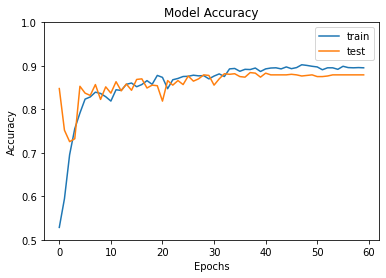

In [ ]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epochs')
plt.legend(['train', 'test'])
plt.ylim([0.5,1])
plt.show()

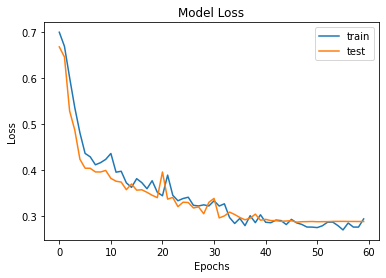

In [ ]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epochs')
plt.legend(['train', 'test'])
#plt.ylim(0.0,)
plt.show()

In [ ]:
model.save('saved_model/trained.h5', save_format='h5')

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:2001: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  warnings.warn('`Model.predict_generator` is deprecated and '


10/10 [==============================] - 5s 477ms/step
Predictions finished
prob:[0.04257521 0.95742476]
BACTERIA/person582_bacteria_2404.jpeg


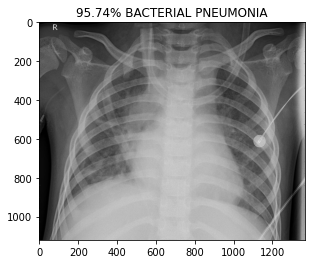

prob:[0.13102548 0.8689745 ]
BACTERIA/person582_bacteria_2405.jpeg


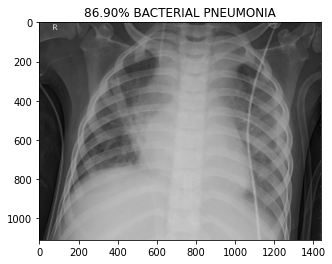

prob:[0.9516698  0.04833018]
BACTERIA/person583_bacteria_2406.jpeg


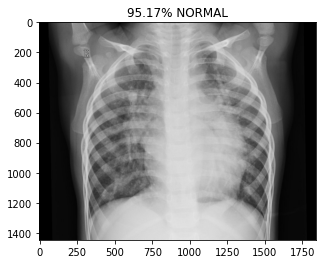

prob:[0.9152106  0.08478937]
BACTERIA/person583_bacteria_2408.jpeg


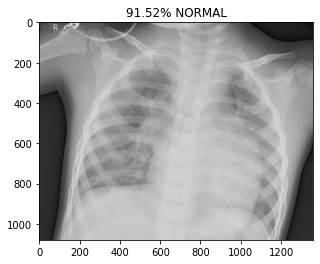

prob:[0.15990229 0.8400978 ]
BACTERIA/person583_bacteria_2409.jpeg


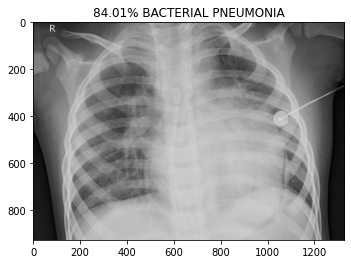

prob:[0.05560406 0.9443959 ]
BACTERIA/person585_bacteria_2411.jpeg


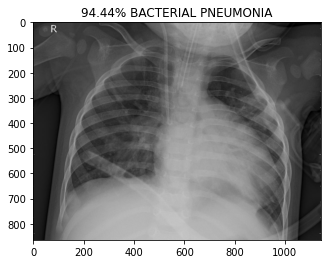

prob:[0.96717125 0.03282875]
BACTERIA/person585_bacteria_2412.jpeg


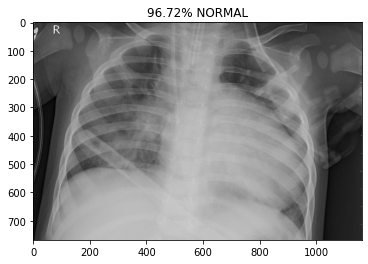

prob:[0.04495129 0.9550487 ]
BACTERIA/person585_bacteria_2413.jpeg


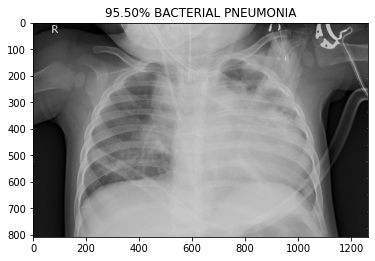

prob:[0.991565   0.00843505]
BACTERIA/person585_bacteria_2414.jpeg


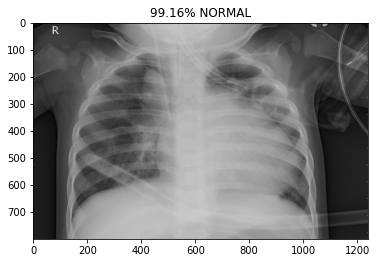

prob:[0.99535745 0.00464249]
BACTERIA/person585_bacteria_2415.jpeg


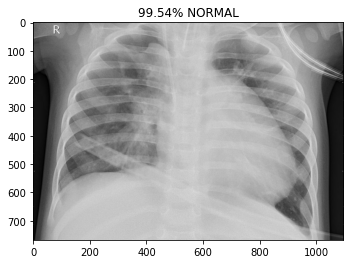

prob:[0.0562118 0.9437882]
BACTERIA/person585_bacteria_2416.jpeg


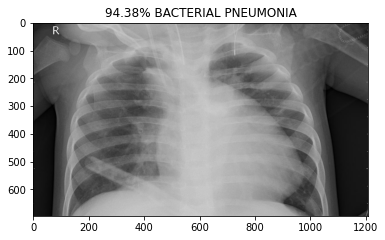

prob:[0.9790025  0.02099751]
BACTERIA/person586_bacteria_2417.jpeg


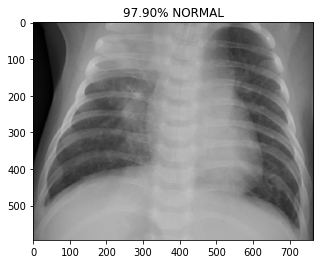

prob:[0.473803   0.52619696]
BACTERIA/person586_bacteria_2418.jpeg


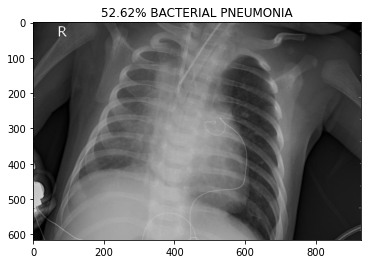

prob:[0.9711419  0.02885808]
BACTERIA/person586_bacteria_2420.jpeg


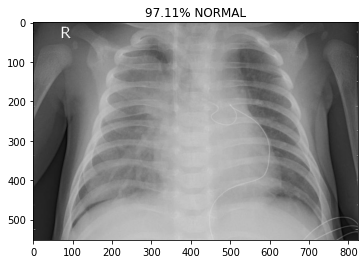

prob:[0.9938427  0.00615727]
BACTERIA/person587_bacteria_2421.jpeg


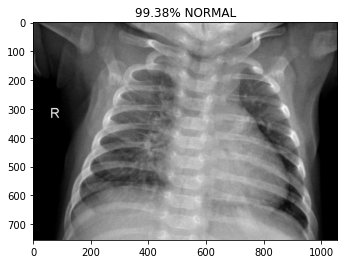

prob:[0.2479894 0.7520106]
BACTERIA/person588_bacteria_2422.jpeg


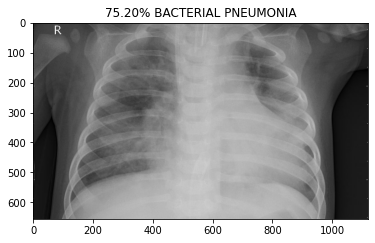

prob:[0.992695   0.00730498]
BACTERIA/person588_bacteria_2423.jpeg


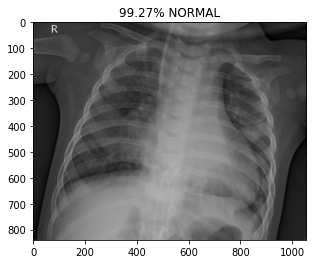

prob:[0.9408239  0.05917613]
BACTERIA/person589_bacteria_2424.jpeg


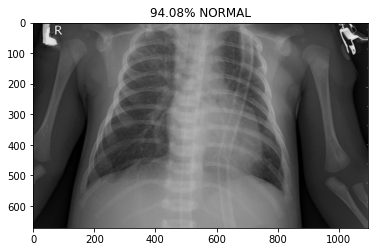

prob:[0.9918425  0.00815752]
BACTERIA/person589_bacteria_2425.jpeg


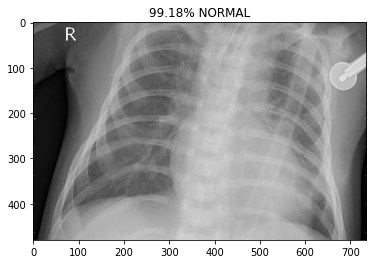

prob:[0.05120507 0.9487949 ]
BACTERIA/person590_bacteria_2428.jpeg


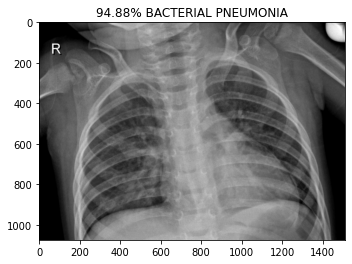

prob:[0.06503114 0.9349689 ]
BACTERIA/person591_bacteria_2429.jpeg


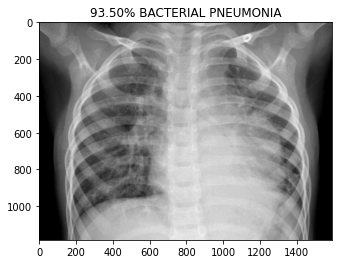

prob:[0.98093593 0.01906412]
BACTERIA/person592_bacteria_2431.jpeg


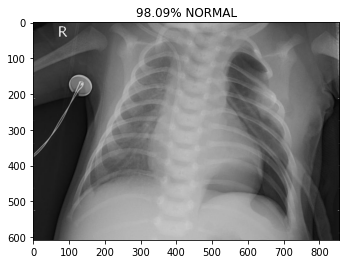

prob:[0.9876846  0.01231536]
BACTERIA/person592_bacteria_2434.jpeg


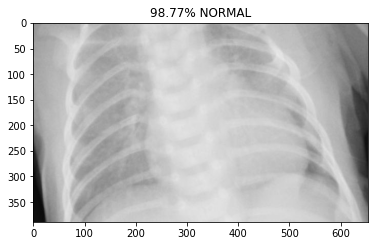

prob:[0.92426807 0.0757319 ]
BACTERIA/person593_bacteria_2435.jpeg


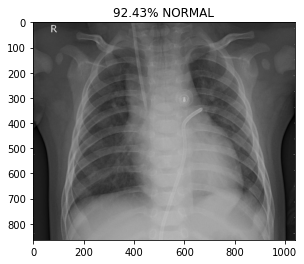

prob:[0.07652662 0.9234734 ]
BACTERIA/person594_bacteria_2436.jpeg


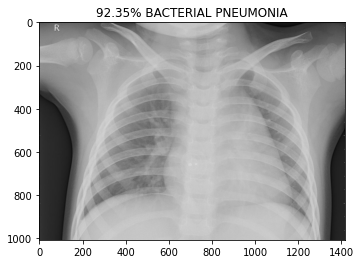

prob:[0.0411992  0.95880085]
BACTERIA/person595_bacteria_2438.jpeg


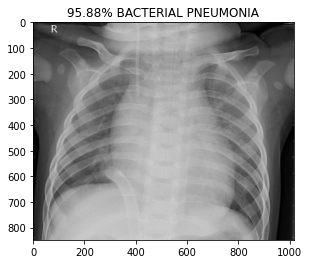

prob:[0.9250494 0.0749506]
BACTERIA/person596_bacteria_2440.jpeg


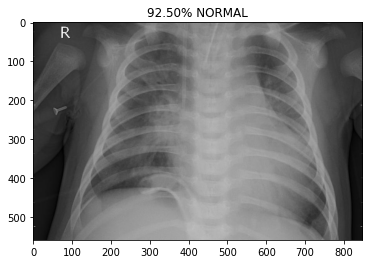

prob:[0.99350595 0.00649409]
BACTERIA/person596_bacteria_2441.jpeg


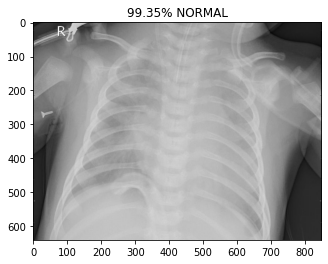

prob:[0.11851396 0.881486  ]
BACTERIA/person596_bacteria_2443.jpeg


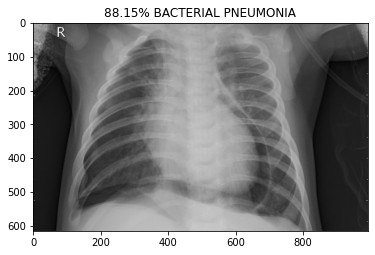

prob:[0.05458914 0.94541085]
BACTERIA/person596_bacteria_2444.jpeg


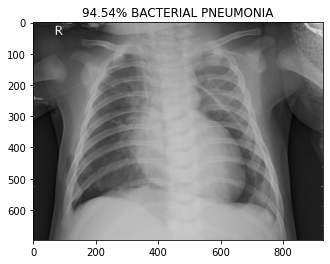

prob:[0.9158325  0.08416748]
BACTERIA/person596_bacteria_2445.jpeg


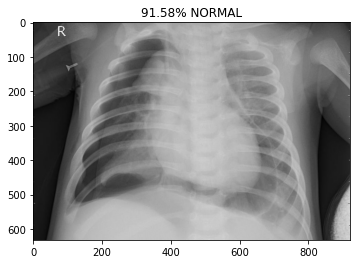

prob:[0.2906738 0.7093262]
BACTERIA/person596_bacteria_2446.jpeg


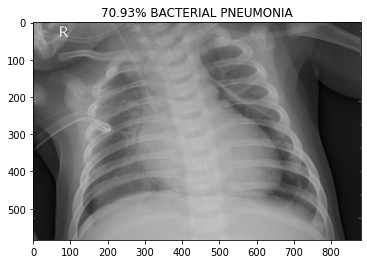

prob:[0.06219695 0.93780303]
BACTERIA/person596_bacteria_2447.jpeg


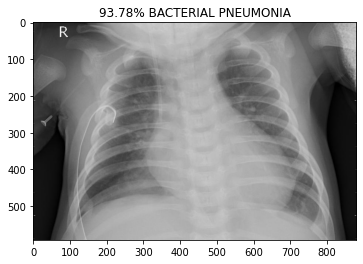

prob:[0.9930033  0.00699665]
BACTERIA/person596_bacteria_2449.jpeg


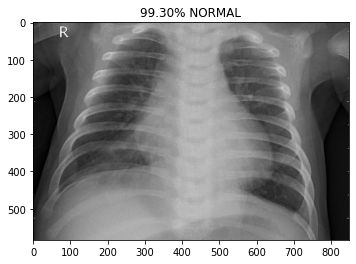

prob:[0.05069853 0.9493015 ]
BACTERIA/person597_bacteria_2450.jpeg


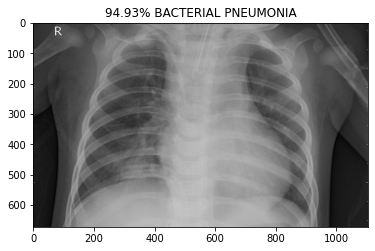

prob:[0.04397783 0.9560222 ]
BACTERIA/person597_bacteria_2451.jpeg


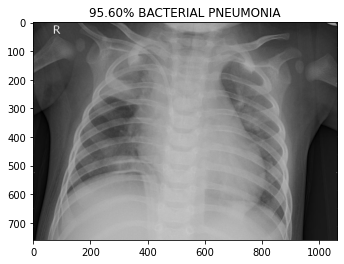

prob:[0.13263729 0.8673627 ]
BACTERIA/person598_bacteria_2453.jpeg


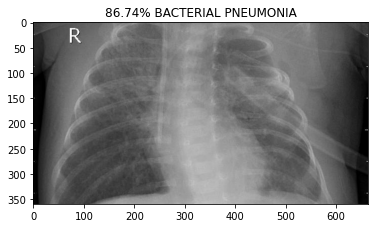

prob:[0.99096745 0.00903257]
BACTERIA/person598_bacteria_2454.jpeg


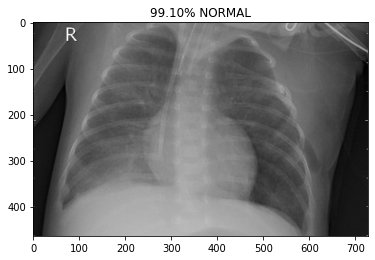

prob:[0.04482058 0.9551794 ]
BACTERIA/person599_bacteria_2455.jpeg


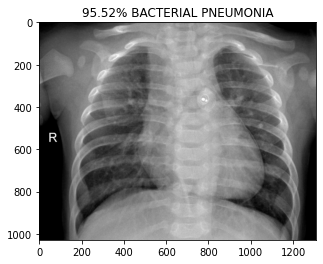

prob:[0.07824516 0.92175484]
BACTERIA/person600_bacteria_2456.jpeg


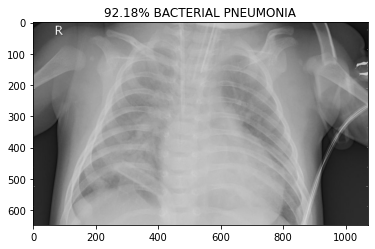

prob:[0.08155391 0.91844606]
BACTERIA/person600_bacteria_2457.jpeg


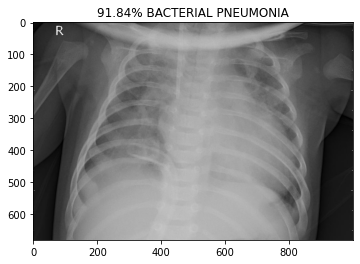

prob:[0.08729726 0.91270274]
BACTERIA/person600_bacteria_2458.jpeg


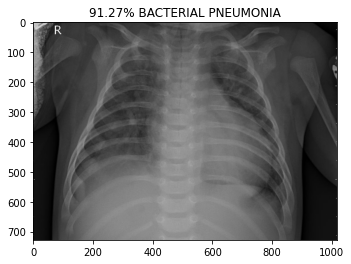

prob:[0.18407162 0.8159284 ]
BACTERIA/person601_bacteria_2459.jpeg


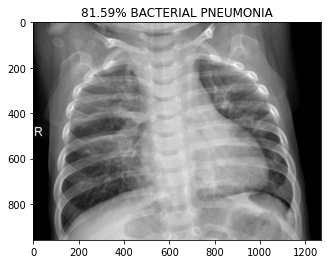

prob:[0.15138751 0.8486125 ]
BACTERIA/person602_bacteria_2460.jpeg


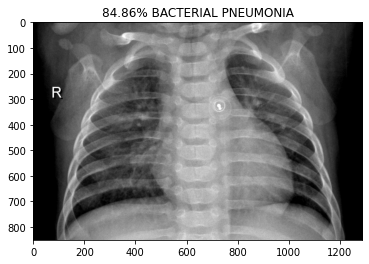

prob:[0.77785474 0.22214526]
BACTERIA/person603_bacteria_2461.jpeg


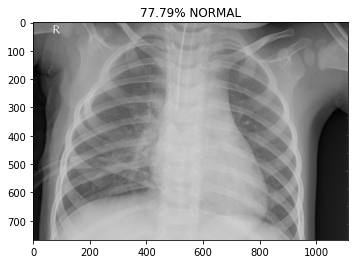

prob:[0.13046269 0.8695373 ]
BACTERIA/person604_bacteria_2462.jpeg


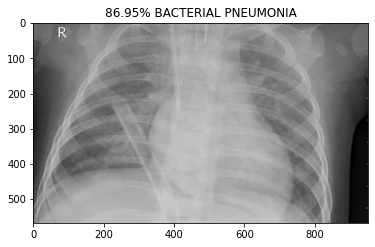

prob:[0.9870164  0.01298365]
BACTERIA/person604_bacteria_2463.jpeg


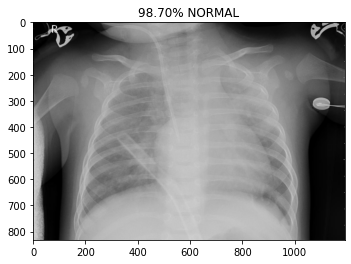

prob:[0.9425112  0.05748881]
BACTERIA/person605_bacteria_2464.jpeg


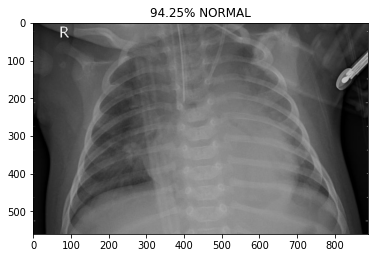

prob:[0.03381794 0.96618205]
BACTERIA/person605_bacteria_2465.jpeg


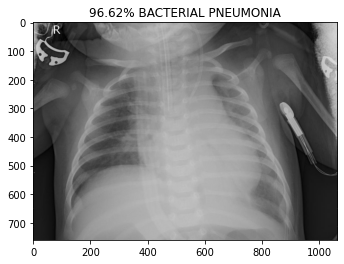

prob:[0.9925518 0.0074482]
BACTERIA/person605_bacteria_2466.jpeg


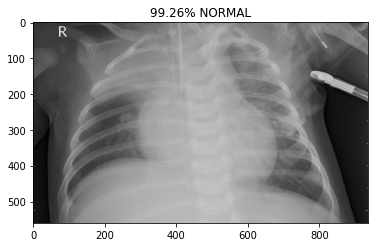

prob:[0.08445571 0.91554433]
BACTERIA/person605_bacteria_2467.jpeg


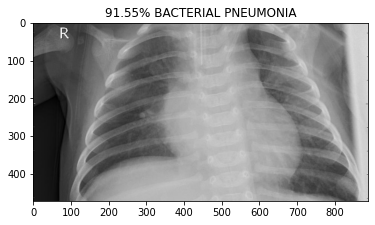

prob:[0.19364047 0.8063595 ]
BACTERIA/person605_bacteria_2468.jpeg


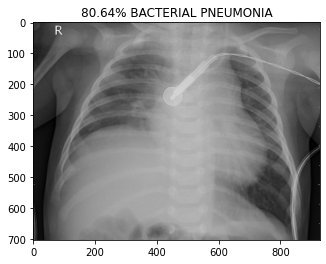

prob:[0.05492046 0.9450795 ]
BACTERIA/person606_bacteria_2469.jpeg


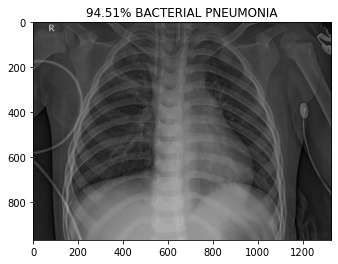

prob:[0.13083206 0.869168  ]
BACTERIA/person607_bacteria_2470.jpeg


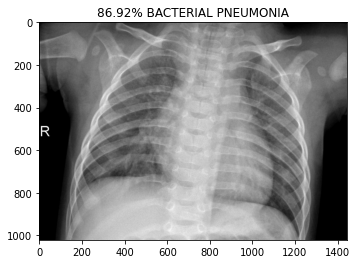

prob:[0.9757646  0.02423543]
BACTERIA/person608_bacteria_2471.jpeg


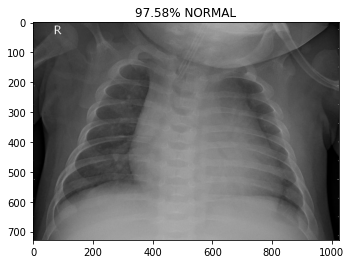

prob:[0.14776085 0.8522392 ]
BACTERIA/person608_bacteria_2472.jpeg


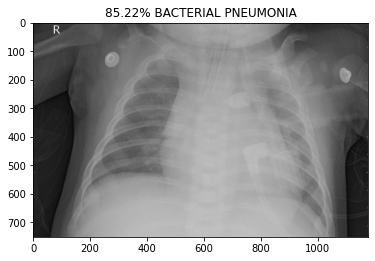

prob:[0.98294306 0.01705699]
BACTERIA/person608_bacteria_2473.jpeg


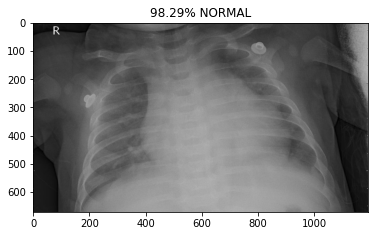

prob:[0.22892618 0.7710738 ]
BACTERIA/person609_bacteria_2474.jpeg


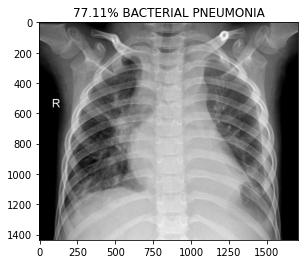

prob:[0.1253962  0.87460375]
BACTERIA/person610_bacteria_2475.jpeg


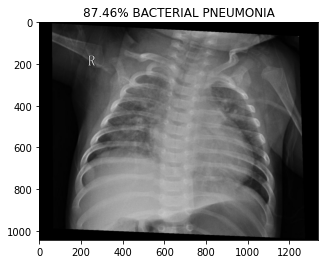

prob:[0.07405382 0.9259461 ]
BACTERIA/person611_bacteria_2476.jpeg


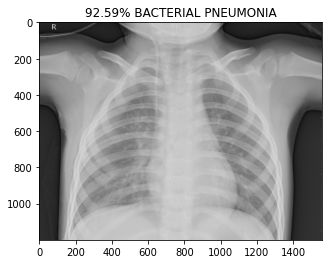

prob:[0.5448152  0.45518482]
BACTERIA/person612_bacteria_2477.jpeg


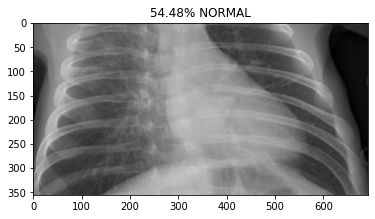

prob:[0.07591954 0.92408043]
BACTERIA/person612_bacteria_2478.jpeg


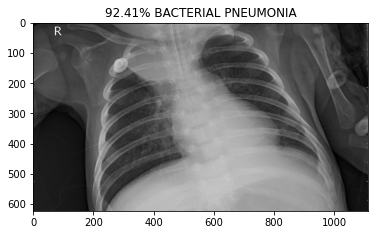

prob:[0.24971625 0.7502837 ]
BACTERIA/person613_bacteria_2479.jpeg


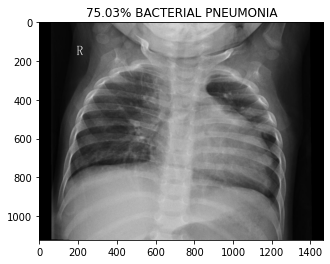

prob:[0.48694783 0.51305217]
BACTERIA/person614_bacteria_2480.jpeg


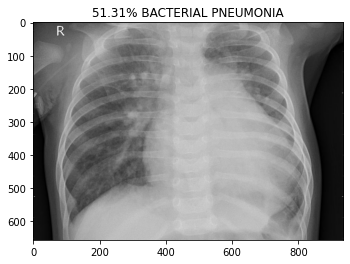

prob:[0.9900746  0.00992536]
BACTERIA/person614_bacteria_2481.jpeg


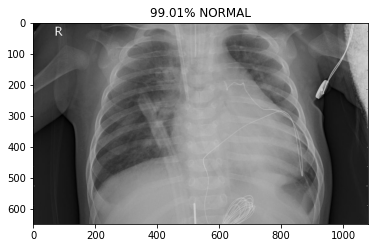

prob:[0.25592476 0.74407524]
BACTERIA/person614_bacteria_2483.jpeg


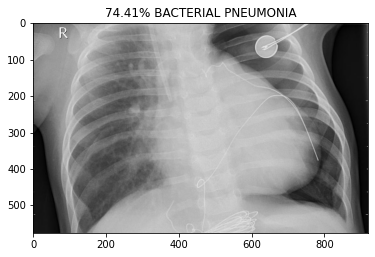

prob:[0.98620504 0.01379495]
BACTERIA/person616_bacteria_2487.jpeg


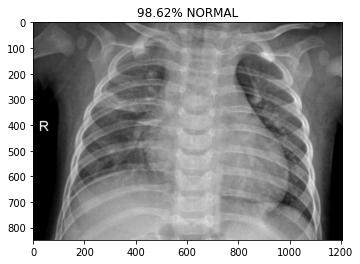

prob:[0.9307427  0.06925726]
BACTERIA/person617_bacteria_2488.jpeg


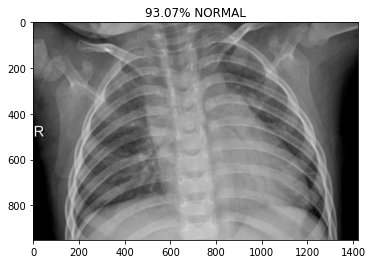

prob:[0.08926172 0.9107383 ]
BACTERIA/person618_bacteria_2489.jpeg


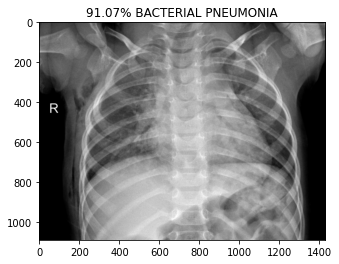

prob:[0.97860307 0.0213969 ]
BACTERIA/person619_bacteria_2490.jpeg


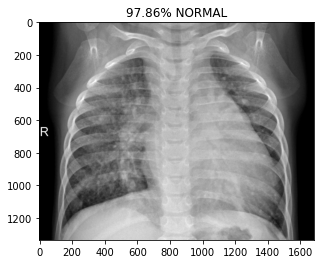

prob:[0.94735426 0.05264577]
BACTERIA/person619_bacteria_2491.jpeg


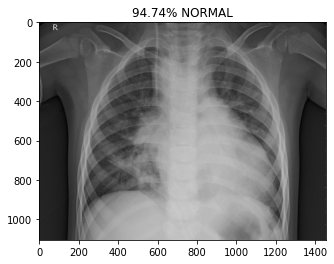

prob:[0.17061739 0.8293826 ]
BACTERIA/person620_bacteria_2492.jpeg


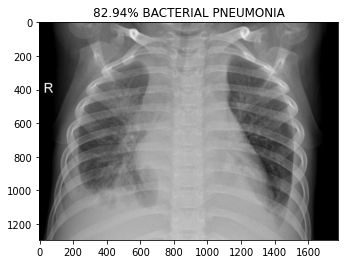

prob:[0.06130647 0.93869346]
BACTERIA/person622_bacteria_2494.jpeg


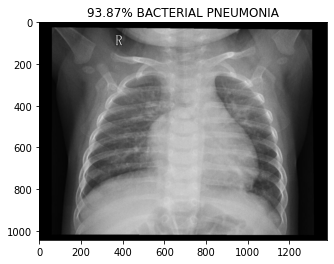

prob:[0.06719932 0.93280065]
BACTERIA/person623_bacteria_2495.jpeg


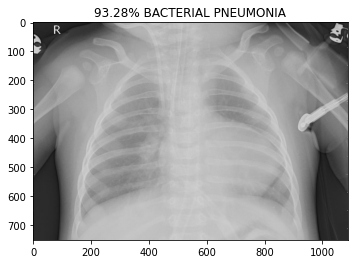

prob:[0.92711407 0.07288587]
BACTERIA/person623_bacteria_2496.jpeg


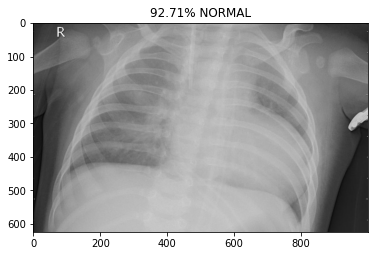

prob:[0.48175612 0.5182439 ]
BACTERIA/person624_bacteria_2497.jpeg


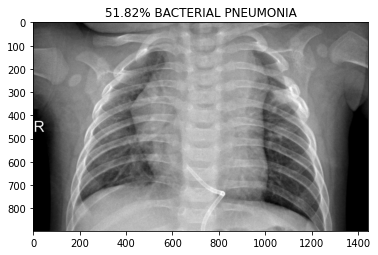

prob:[0.9870244 0.0129756]
BACTERIA/person625_bacteria_2499.jpeg


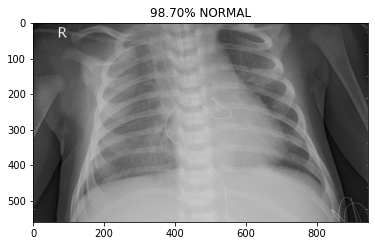

prob:[0.29997706 0.7000229 ]
BACTERIA/person625_bacteria_2500.jpeg


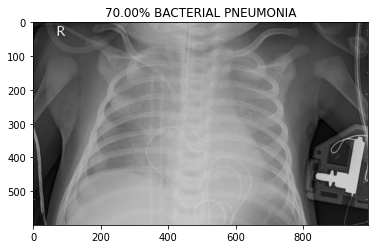

prob:[0.10084666 0.89915335]
BACTERIA/person626_bacteria_2502.jpeg


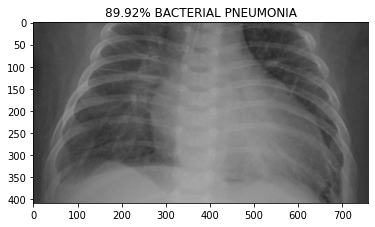

prob:[0.04564476 0.95435524]
BACTERIA/person628_bacteria_2505.jpeg


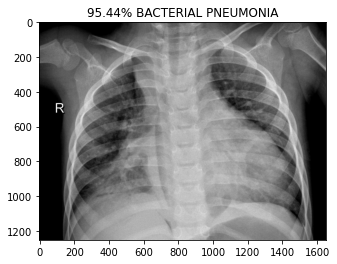

prob:[0.99114066 0.00885941]
BACTERIA/person629_bacteria_2506.jpeg


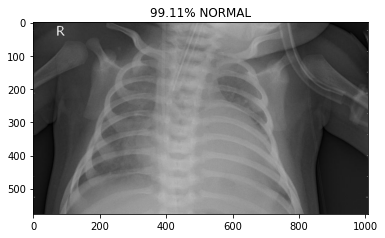

prob:[0.4658064  0.53419363]
BACTERIA/person629_bacteria_2507.jpeg


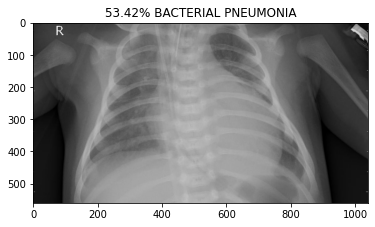

prob:[0.9795877  0.02041227]
BACTERIA/person629_bacteria_2508.jpeg


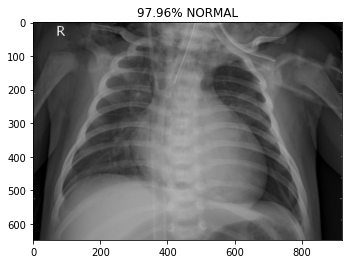

prob:[0.12177315 0.8782269 ]
BACTERIA/person629_bacteria_2509.jpeg


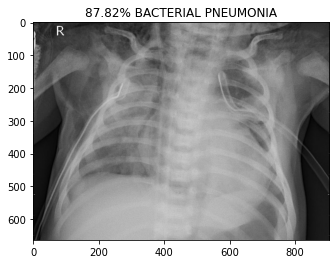

prob:[0.9904508  0.00954927]
BACTERIA/person629_bacteria_2510.jpeg


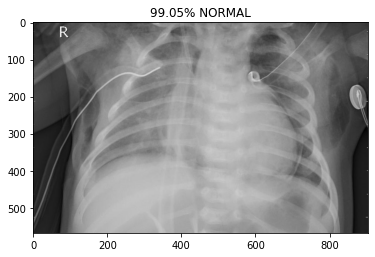

prob:[0.9781677  0.02183223]
BACTERIA/person630_bacteria_2512.jpeg


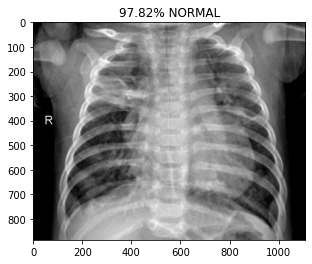

prob:[0.2108078 0.7891922]
BACTERIA/person630_bacteria_2513.jpeg


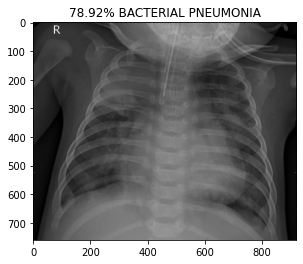

prob:[0.6423562  0.35764384]
BACTERIA/person630_bacteria_2514.jpeg


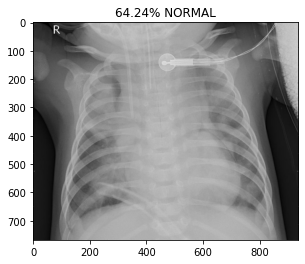

prob:[0.96874523 0.0312548 ]
BACTERIA/person630_bacteria_2515.jpeg


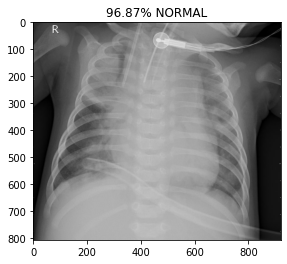

prob:[0.10842743 0.89157254]
BACTERIA/person630_bacteria_2516.jpeg


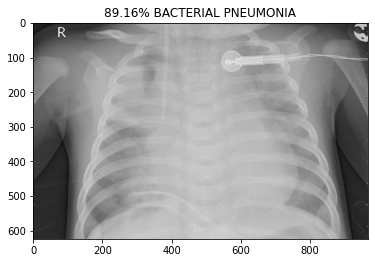

prob:[0.17356616 0.8264338 ]
BACTERIA/person632_bacteria_2520.jpeg


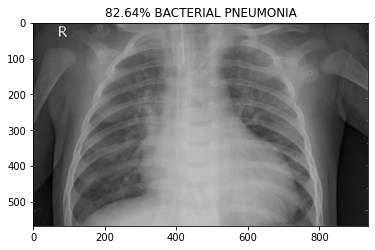

prob:[0.09996247 0.9000375 ]
BACTERIA/person632_bacteria_2521.jpeg


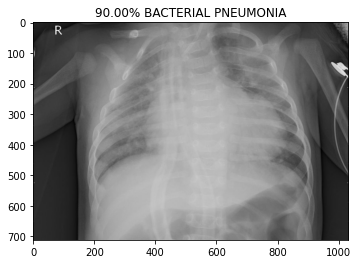

prob:[0.99218243 0.0078176 ]
BACTERIA/person633_bacteria_2522.jpeg


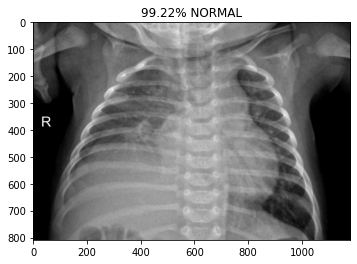

prob:[0.04470413 0.9552959 ]
BACTERIA/person634_bacteria_2525.jpeg


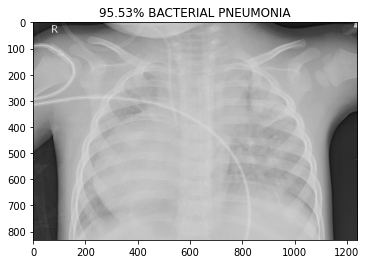

prob:[0.9930201  0.00697985]
BACTERIA/person635_bacteria_2526.jpeg


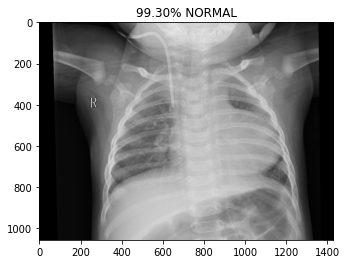

prob:[0.15764187 0.8423581 ]
BACTERIA/person636_bacteria_2527.jpeg


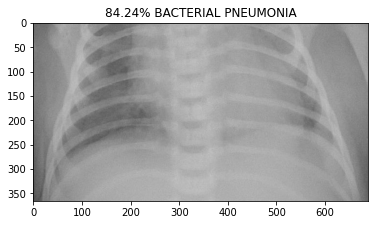

prob:[0.42024082 0.57975924]
BACTERIA/person637_bacteria_2528.jpeg


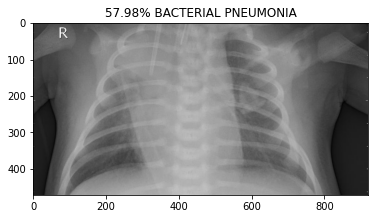

prob:[0.91174823 0.08825172]
BACTERIA/person637_bacteria_2529.jpeg


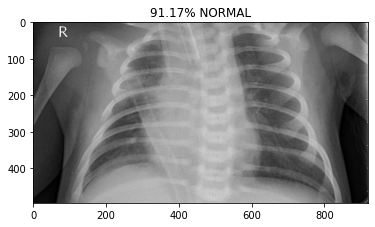

prob:[0.07192484 0.9280752 ]
BACTERIA/person640_bacteria_2532.jpeg


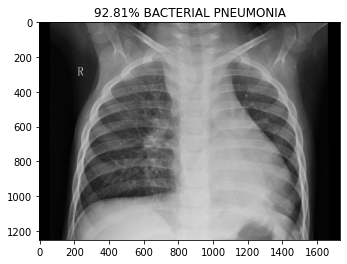

prob:[0.9696509  0.03034909]
BACTERIA/person641_bacteria_2533.jpeg


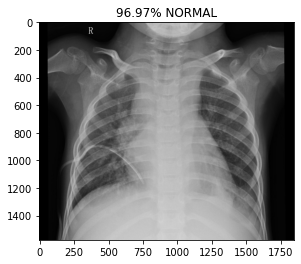

prob:[0.2125586  0.78744143]
BACTERIA/person643_bacteria_2534.jpeg


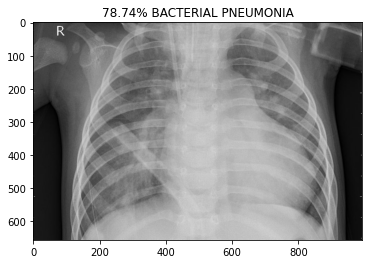

prob:[0.10328755 0.8967125 ]
BACTERIA/person644_bacteria_2536.jpeg


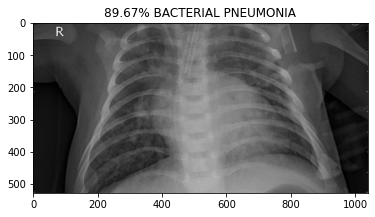

prob:[0.06417463 0.9358254 ]
BACTERIA/person645_bacteria_2537.jpeg


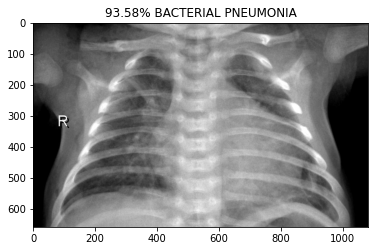

prob:[0.09336162 0.9066384 ]
BACTERIA/person646_bacteria_2538.jpeg


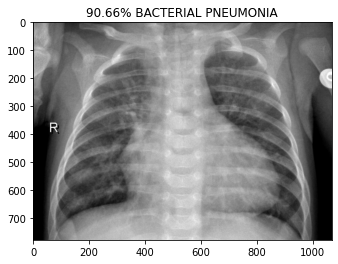

prob:[0.15468726 0.8453127 ]
BACTERIA/person647_bacteria_2539.jpeg


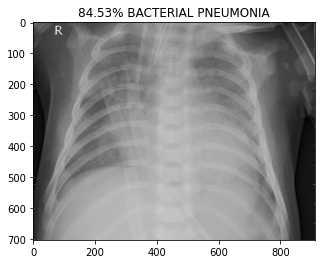

prob:[0.964188   0.03581197]
BACTERIA/person648_bacteria_2540.jpeg


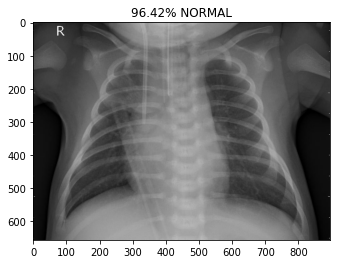

prob:[0.81537926 0.18462077]
BACTERIA/person649_bacteria_2541.jpeg


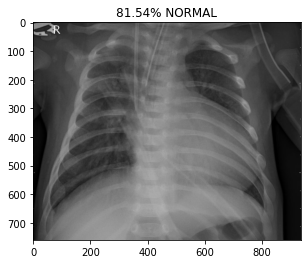

prob:[0.07782143 0.9221785 ]
BACTERIA/person650_bacteria_2542.jpeg


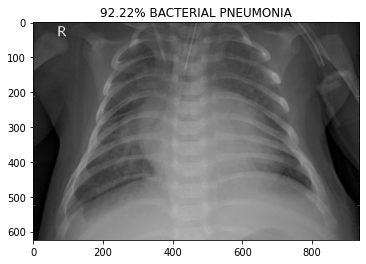

prob:[0.07594382 0.9240562 ]
BACTERIA/person651_bacteria_2543.jpeg


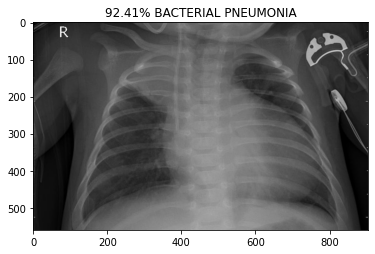

prob:[0.98876244 0.01123759]
BACTERIA/person652_bacteria_2544.jpeg


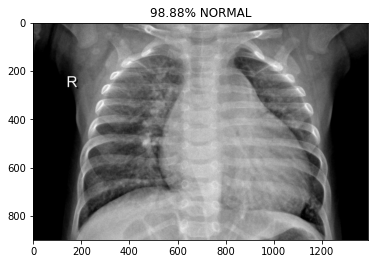

prob:[0.57592404 0.424076  ]
BACTERIA/person653_bacteria_2545.jpeg


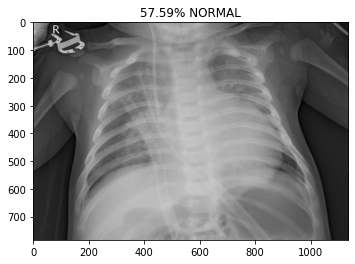

prob:[0.9795951  0.02040487]
BACTERIA/person654_bacteria_2546.jpeg


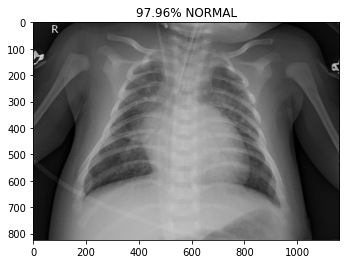

prob:[0.18876001 0.81124   ]
BACTERIA/person655_bacteria_2547.jpeg


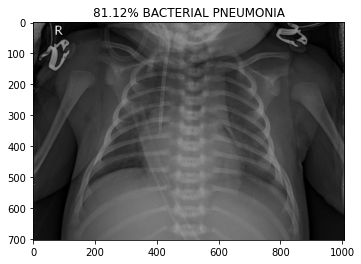

prob:[0.15516411 0.8448359 ]
BACTERIA/person656_bacteria_2548.jpeg


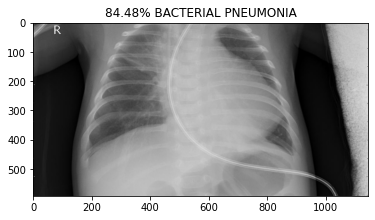

prob:[0.06199915 0.9380008 ]
BACTERIA/person657_bacteria_2549.jpeg


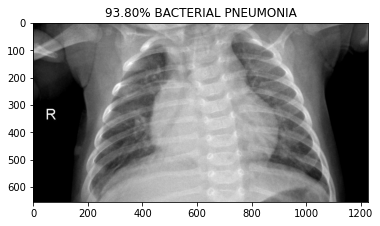

prob:[0.41810742 0.5818926 ]
BACTERIA/person658_bacteria_2550.jpeg


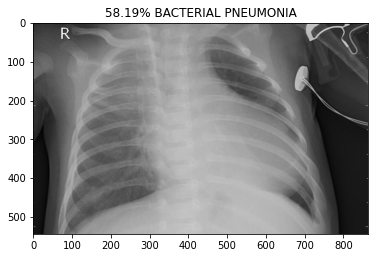

prob:[0.03737652 0.9626235 ]
BACTERIA/person659_bacteria_2551.jpeg


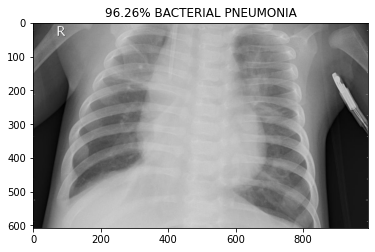

prob:[0.9206439  0.07935613]
BACTERIA/person660_bacteria_2552.jpeg


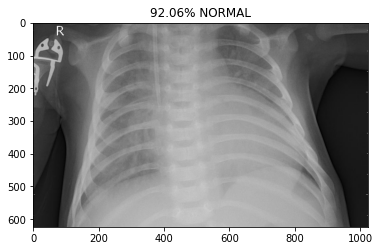

prob:[0.97921556 0.02078439]
BACTERIA/person661_bacteria_2553.jpeg


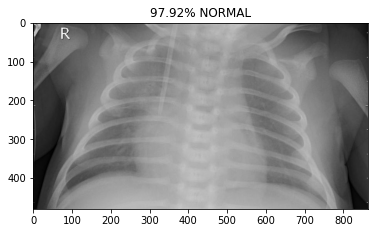

prob:[0.08886727 0.91113275]
BACTERIA/person662_bacteria_2554.jpeg


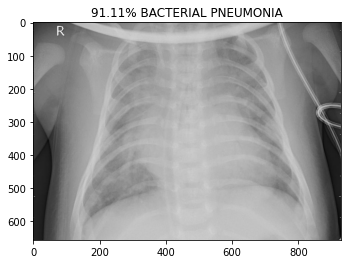

prob:[0.06657924 0.93342084]
BACTERIA/person663_bacteria_2555.jpeg


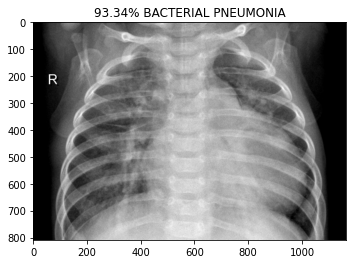

prob:[0.09129658 0.9087034 ]
BACTERIA/person665_bacteria_2557.jpeg


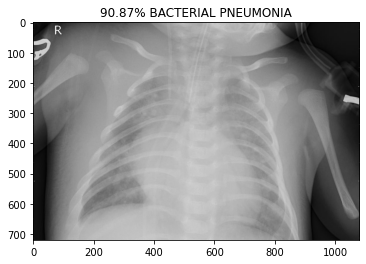

prob:[0.99229664 0.0077033 ]
BACTERIA/person666_bacteria_2558.jpeg


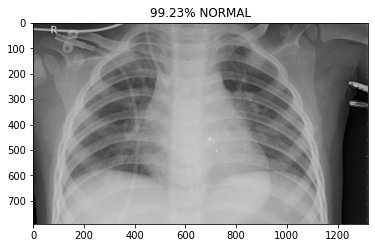

prob:[0.92925304 0.07074693]
BACTERIA/person669_bacteria_2561.jpeg


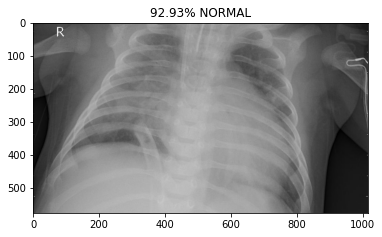

prob:[0.04916211 0.95083797]
BACTERIA/person669_bacteria_2562.jpeg


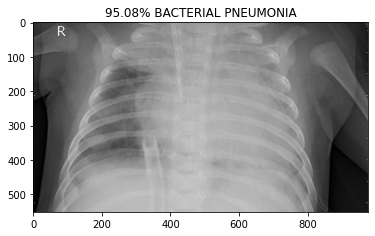

prob:[0.07387397 0.92612606]
BACTERIA/person670_bacteria_2563.jpeg


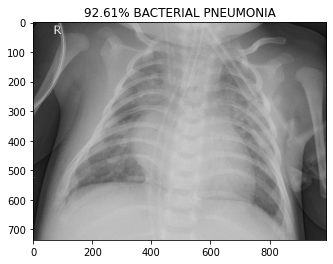

prob:[0.11503567 0.88496435]
BACTERIA/person671_bacteria_2564.jpeg


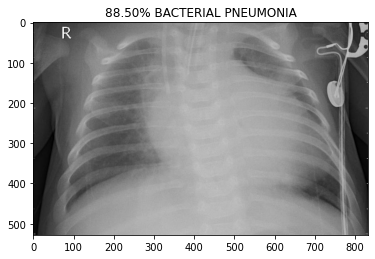

prob:[0.23980047 0.76019955]
BACTERIA/person672_bacteria_2565.jpeg


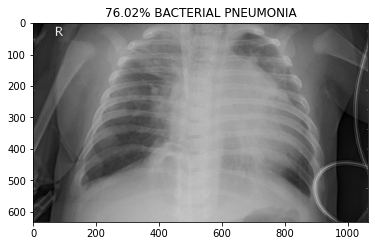

prob:[0.4128176 0.5871824]
BACTERIA/person673_bacteria_2566.jpeg


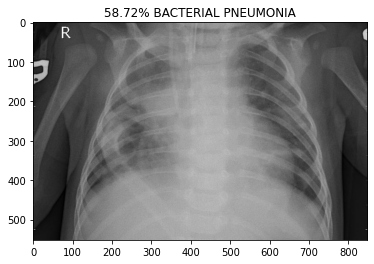

prob:[0.97859704 0.02140296]
BACTERIA/person674_bacteria_2568.jpeg


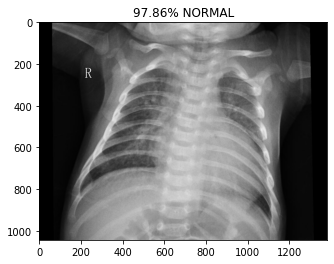

prob:[0.9686086  0.03139133]
BACTERIA/person675_bacteria_2569.jpeg


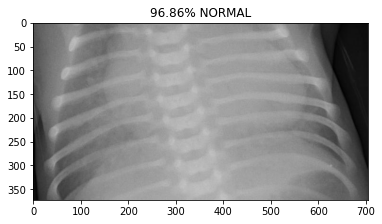

prob:[0.08669865 0.91330135]
BACTERIA/person677_bacteria_2571.jpeg


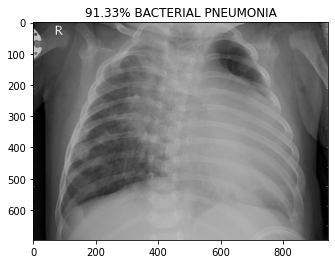

prob:[0.99457514 0.00542479]
BACTERIA/person678_bacteria_2572.jpeg


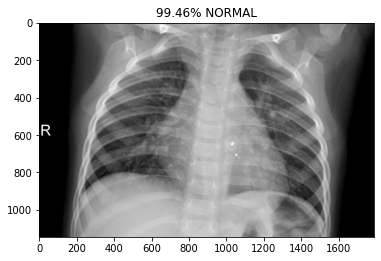

prob:[0.15772937 0.8422707 ]
BACTERIA/person680_bacteria_2575.jpeg


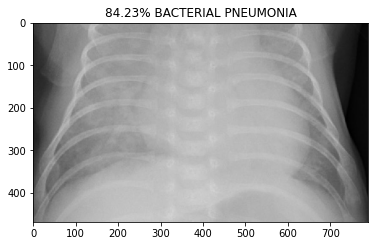

prob:[0.31685382 0.6831462 ]
BACTERIA/person681_bacteria_2576.jpeg


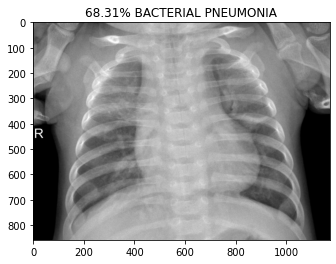

prob:[0.970682   0.02931801]
BACTERIA/person683_bacteria_2578.jpeg


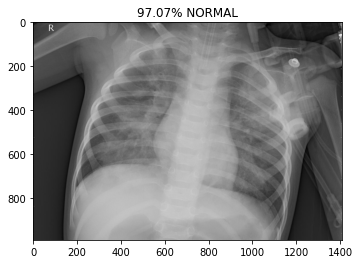

prob:[0.10252853 0.8974714 ]
BACTERIA/person684_bacteria_2580.jpeg


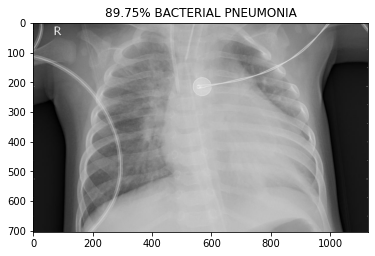

prob:[0.1339249  0.86607516]
BACTERIA/person685_bacteria_2581.jpeg


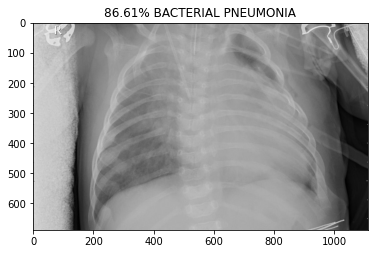

prob:[0.06171184 0.9382882 ]
BACTERIA/person687_bacteria_2583.jpeg


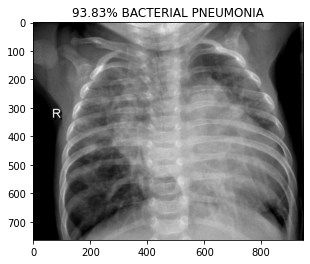

prob:[0.12207512 0.87792486]
BACTERIA/person688_bacteria_2584.jpeg


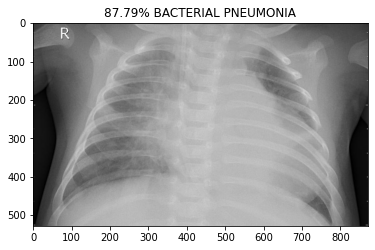

prob:[0.90147704 0.09852301]
BACTERIA/person689_bacteria_2585.jpeg


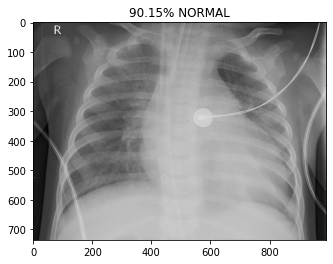

prob:[0.98377097 0.01622909]
BACTERIA/person689_bacteria_2586.jpeg


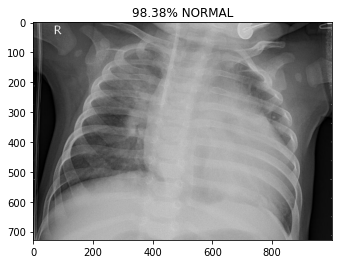

prob:[0.99233294 0.00766703]
BACTERIA/person690_bacteria_2587.jpeg


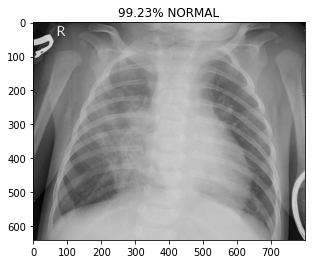

prob:[0.03564477 0.96435523]
BACTERIA/person691_bacteria_2588.jpeg


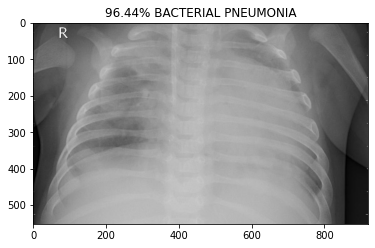

prob:[0.9691756  0.03082444]
BACTERIA/person692_bacteria_2589.jpeg


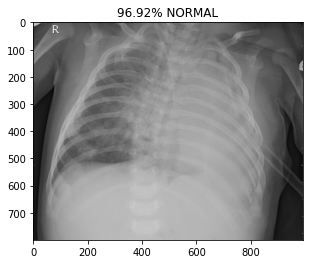

prob:[0.9824539 0.0175461]
BACTERIA/person693_bacteria_2590.jpeg


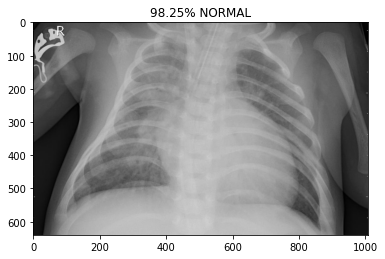

prob:[0.9640384  0.03596156]
BACTERIA/person696_bacteria_2594.jpeg


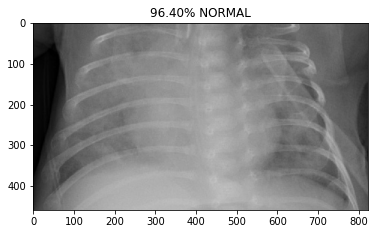

prob:[0.991433   0.00856702]
BACTERIA/person699_bacteria_2598.jpeg


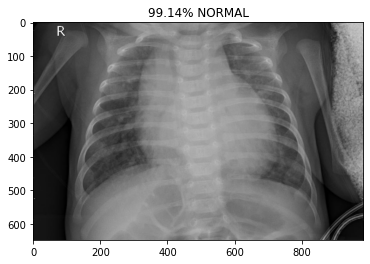

prob:[0.20389786 0.79610217]
BACTERIA/person700_bacteria_2599.jpeg


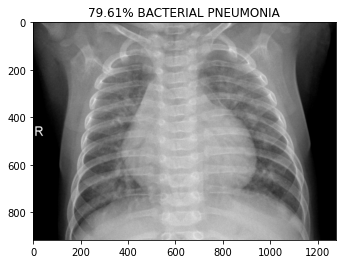

prob:[0.06276301 0.93723696]
BACTERIA/person701_bacteria_2600.jpeg


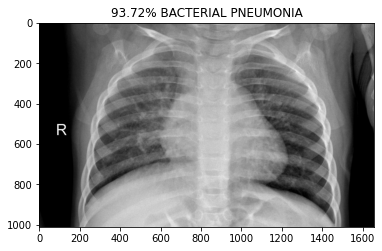

prob:[0.10690939 0.8930906 ]
BACTERIA/person702_bacteria_2601.jpeg


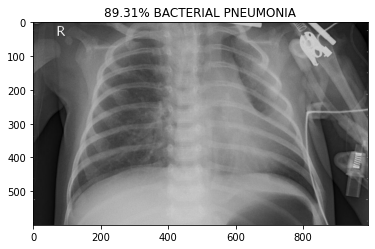

prob:[0.96724933 0.0327507 ]
BACTERIA/person703_bacteria_2602.jpeg


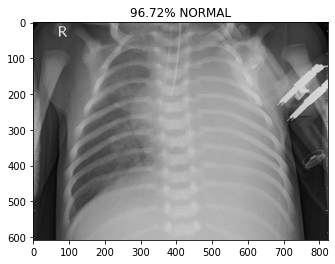

prob:[0.03064698 0.96935296]
BACTERIA/person704_bacteria_2603.jpeg


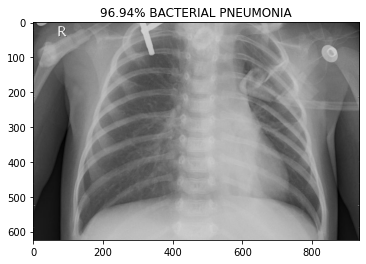

prob:[0.9781141  0.02188591]
BACTERIA/person707_bacteria_2606.jpeg


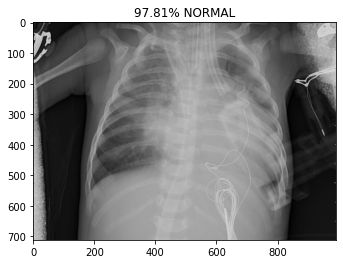

prob:[0.99120986 0.00879016]
BACTERIA/person709_bacteria_2608.jpeg


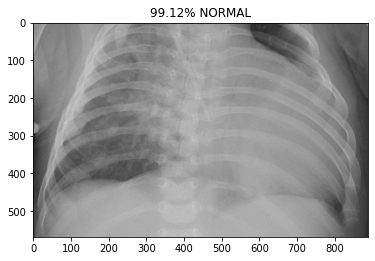

prob:[0.36357412 0.6364259 ]
BACTERIA/person710_bacteria_2611.jpeg


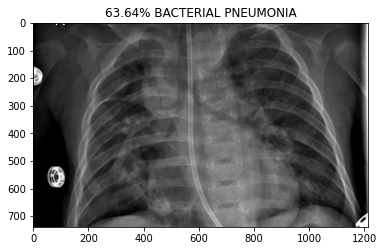

prob:[0.99124616 0.00875378]
BACTERIA/person711_bacteria_2612.jpeg


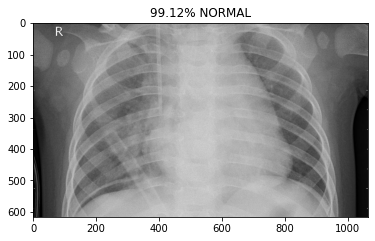

prob:[0.08425674 0.9157433 ]
BACTERIA/person712_bacteria_2613.jpeg


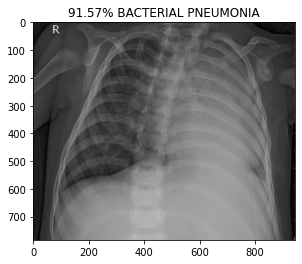

prob:[0.8254367  0.17456323]
BACTERIA/person713_bacteria_2614.jpeg


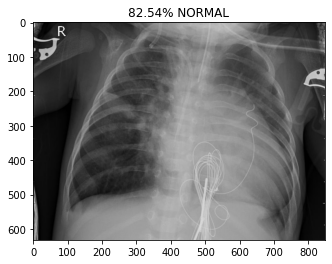

prob:[0.12084075 0.8791593 ]
BACTERIA/person714_bacteria_2615.jpeg


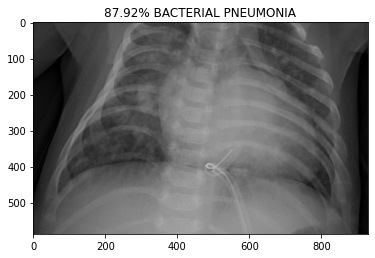

prob:[0.3524299  0.64757013]
BACTERIA/person716_bacteria_2617.jpeg


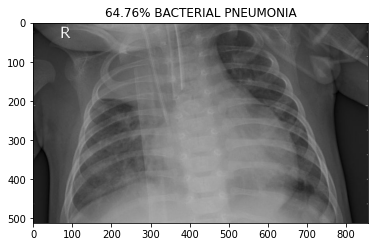

prob:[0.8507206  0.14927937]
BACTERIA/person717_bacteria_2618.jpeg


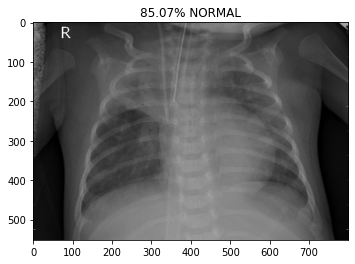

prob:[0.11726517 0.88273484]
BACTERIA/person718_bacteria_2620.jpeg


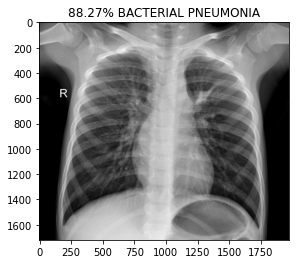

prob:[0.98130953 0.01869049]
BACTERIA/person719_bacteria_2621.jpeg


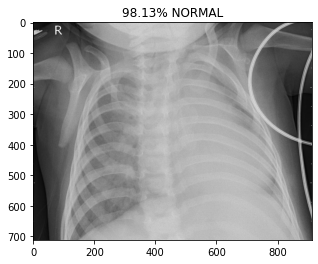

prob:[0.88574934 0.11425069]
BACTERIA/person720_bacteria_2622.jpeg


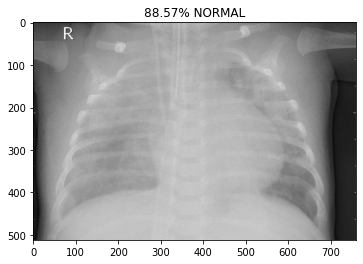

prob:[0.04315638 0.9568436 ]
BACTERIA/person721_bacteria_2623.jpeg


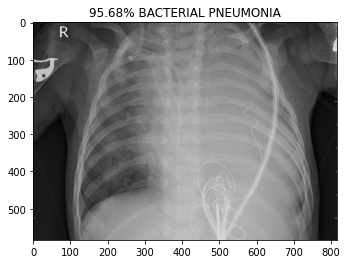

prob:[0.9837991  0.01620089]
BACTERIA/person723_bacteria_2625.jpeg


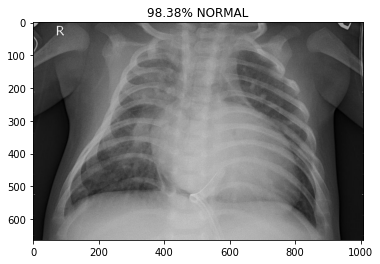

prob:[0.09648099 0.903519  ]
BACTERIA/person724_bacteria_2626.jpeg


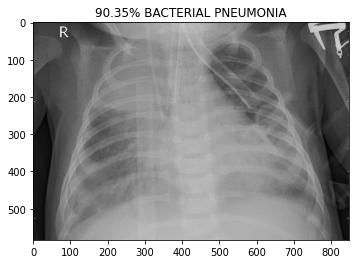

prob:[0.9852211  0.01477894]
BACTERIA/person725_bacteria_2627.jpeg


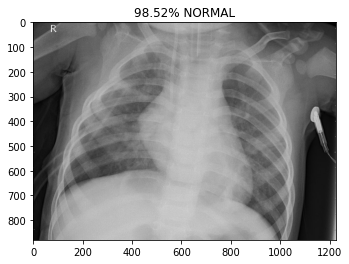

prob:[0.95992005 0.04007989]
BACTERIA/person726_bacteria_2628.jpeg


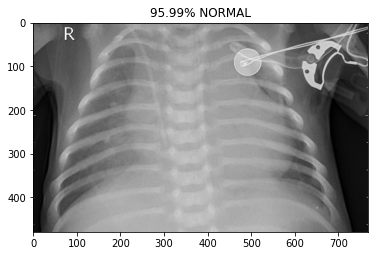

prob:[0.07780402 0.922196  ]
BACTERIA/person727_bacteria_2629.jpeg


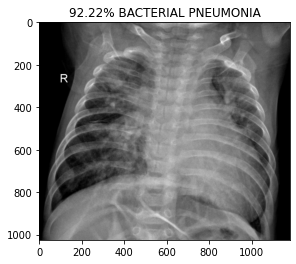

prob:[0.9882565  0.01174351]
BACTERIA/person728_bacteria_2630.jpeg


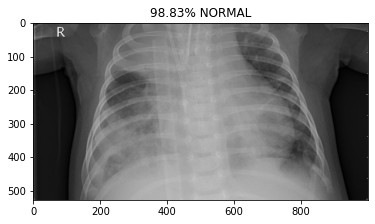

prob:[0.03626134 0.9637387 ]
BACTERIA/person730_bacteria_2632.jpeg


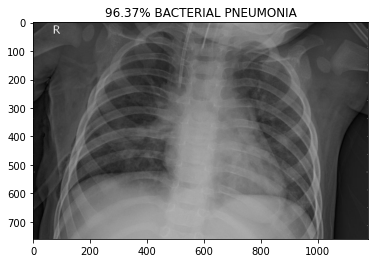

prob:[0.08211417 0.91788584]
BACTERIA/person731_bacteria_2633.jpeg


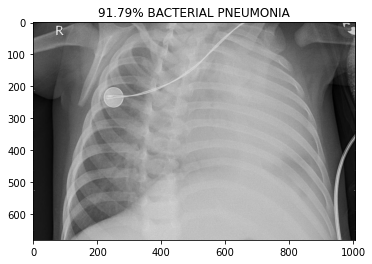

prob:[0.20580705 0.7941929 ]
BACTERIA/person732_bacteria_2634.jpeg


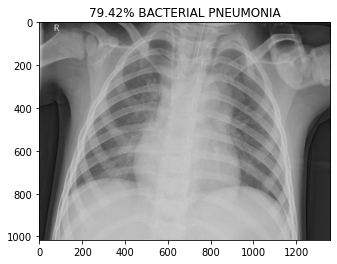

prob:[0.05691623 0.9430838 ]
BACTERIA/person733_bacteria_2635.jpeg


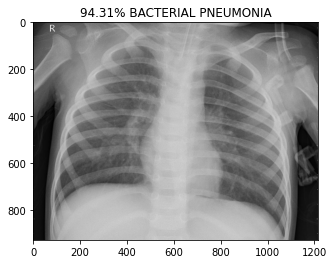

prob:[0.08449366 0.91550636]
BACTERIA/person734_bacteria_2637.jpeg


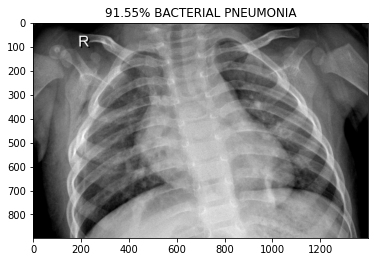

prob:[0.27235204 0.72764796]
BACTERIA/person735_bacteria_2638.jpeg


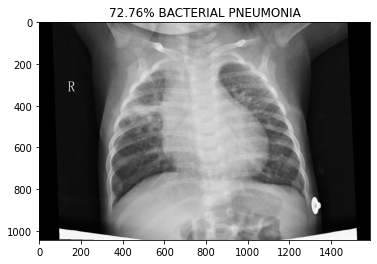

prob:[0.2845334  0.71546656]
BACTERIA/person736_bacteria_2639.jpeg


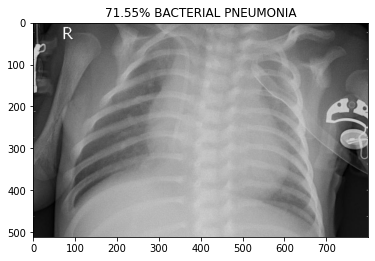

prob:[0.9865768 0.0134232]
BACTERIA/person737_bacteria_2640.jpeg


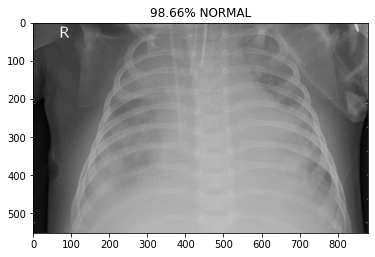

prob:[0.0555719  0.94442815]
BACTERIA/person738_bacteria_2641.jpeg


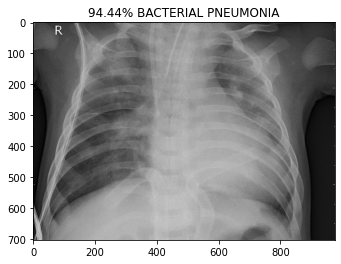

prob:[0.9852459  0.01475414]
BACTERIA/person739_bacteria_2642.jpeg


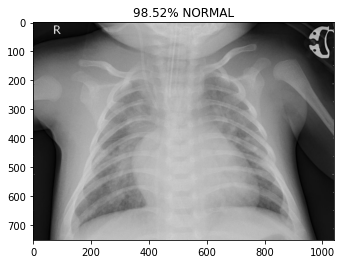

prob:[0.4036866  0.59631336]
BACTERIA/person740_bacteria_2643.jpeg


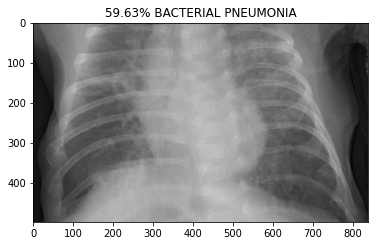

prob:[0.41532186 0.5846782 ]
BACTERIA/person741_bacteria_2644.jpeg


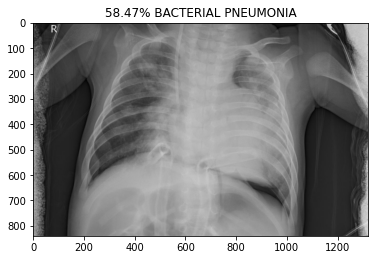

prob:[0.987153   0.01284702]
BACTERIA/person743_bacteria_2646.jpeg


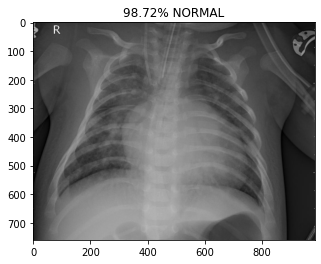

prob:[0.98555344 0.01444655]
BACTERIA/person744_bacteria_2647.jpeg


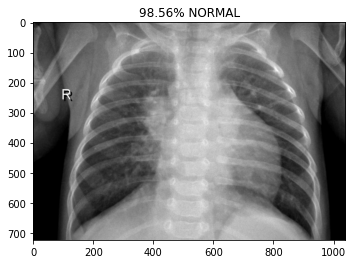

prob:[0.27869102 0.72130895]
BACTERIA/person745_bacteria_2648.jpeg


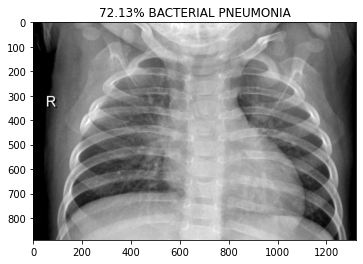

prob:[0.0747344 0.9252656]
BACTERIA/person746_bacteria_2649.jpeg


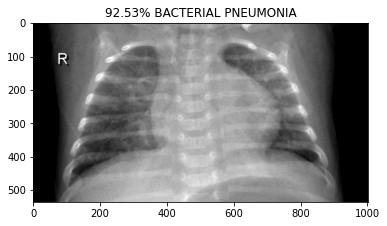

prob:[0.99593616 0.00406385]
BACTERIA/person747_bacteria_2650.jpeg


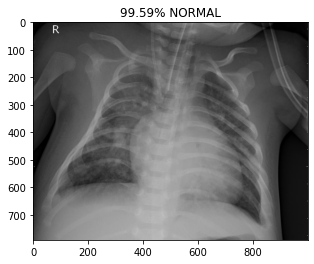

prob:[0.14007197 0.859928  ]
BACTERIA/person749_bacteria_2652.jpeg


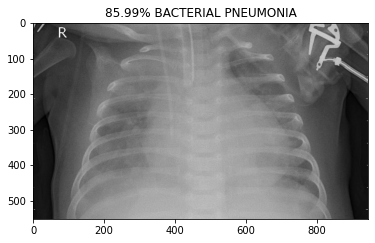

prob:[0.40634897 0.59365106]
BACTERIA/person750_bacteria_2653.jpeg


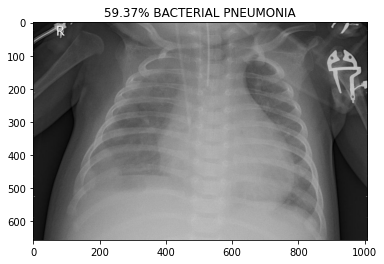

prob:[0.90993756 0.09006248]
BACTERIA/person751_bacteria_2654.jpeg


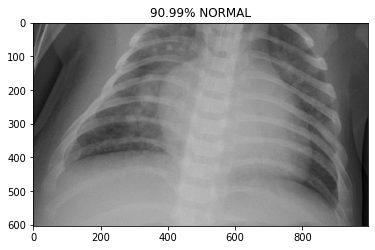

prob:[0.85057265 0.14942728]
BACTERIA/person753_bacteria_2656.jpeg


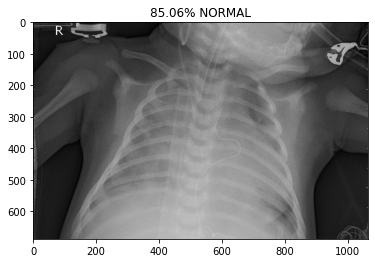

prob:[0.17462486 0.82537514]
BACTERIA/person755_bacteria_2659.jpeg


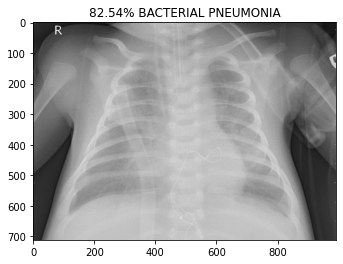

prob:[0.9795237  0.02047628]
BACTERIA/person756_bacteria_2660.jpeg


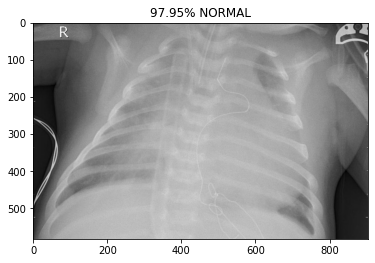

prob:[0.04213777 0.95786226]
BACTERIA/person757_bacteria_2661.jpeg


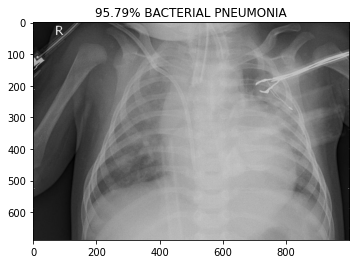

prob:[0.03392249 0.96607757]
BACTERIA/person758_bacteria_2662.jpeg


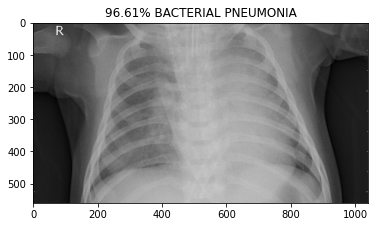

prob:[0.11934212 0.88065785]
BACTERIA/person759_bacteria_2663.jpeg


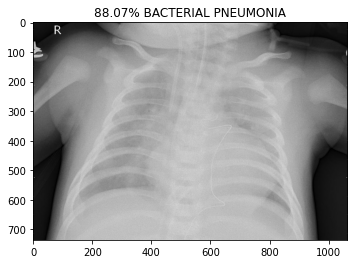

prob:[0.05876987 0.9412301 ]
BACTERIA/person760_bacteria_2664.jpeg


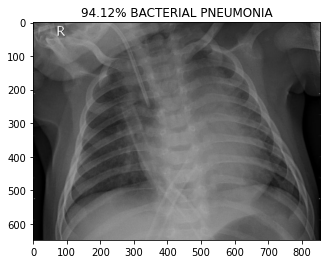

prob:[0.0552325  0.94476753]
BACTERIA/person761_bacteria_2665.jpeg


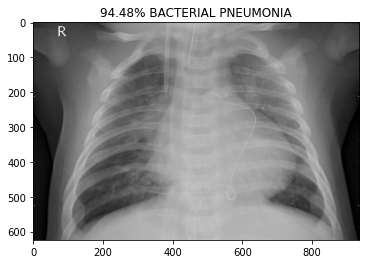

prob:[0.10537493 0.8946251 ]
BACTERIA/person763_bacteria_2667.jpeg


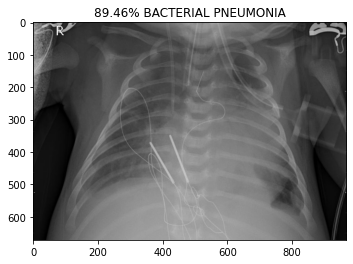

prob:[0.17034368 0.82965636]
BACTERIA/person764_bacteria_2668.jpeg


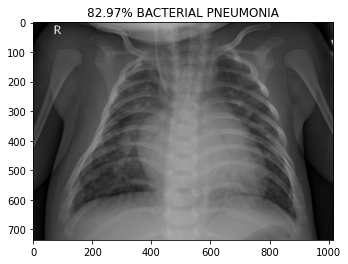

prob:[0.9902686  0.00973134]
BACTERIA/person765_bacteria_2669.jpeg


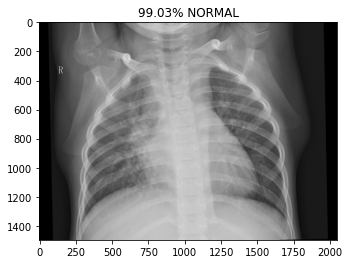

prob:[0.05742335 0.94257665]
BACTERIA/person766_bacteria_2670.jpeg


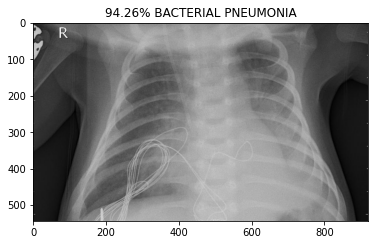

prob:[0.98627913 0.01372089]
BACTERIA/person767_bacteria_2671.jpeg


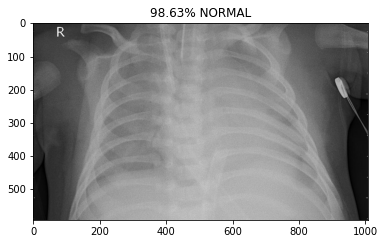

prob:[0.11593005 0.8840699 ]
BACTERIA/person768_bacteria_2672.jpeg


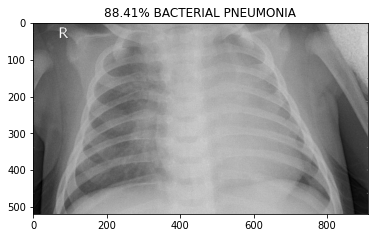

prob:[0.11272514 0.88727486]
BACTERIA/person769_bacteria_2673.jpeg


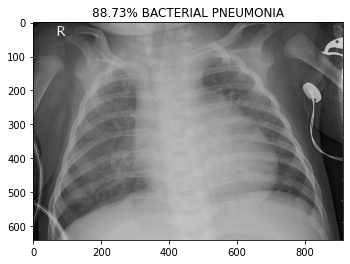

prob:[0.08185881 0.9181412 ]
BACTERIA/person770_bacteria_2674.jpeg


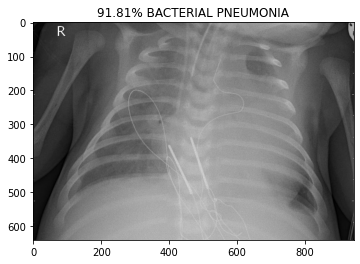

prob:[0.9913356  0.00866444]
BACTERIA/person771_bacteria_2675.jpeg


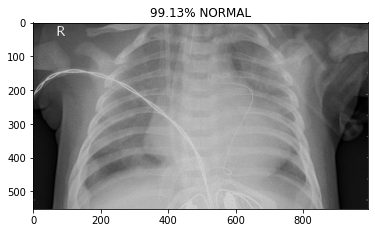

prob:[0.993101   0.00689898]
BACTERIA/person774_bacteria_2678.jpeg


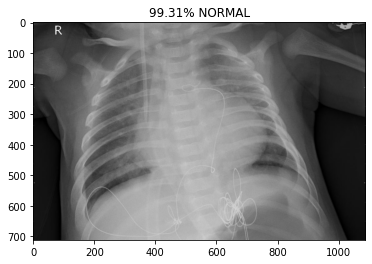

prob:[0.22170728 0.7782927 ]
BACTERIA/person775_bacteria_2679.jpeg


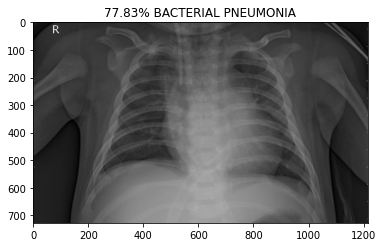

prob:[0.05824633 0.9417537 ]
BACTERIA/person776_bacteria_2680.jpeg


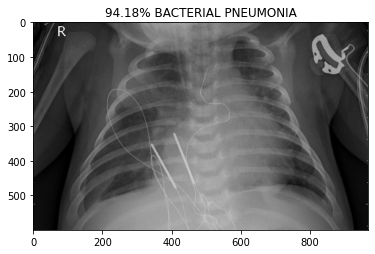

prob:[0.08234125 0.9176588 ]
BACTERIA/person778_bacteria_2682.jpeg


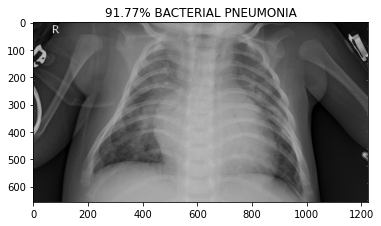

prob:[0.15770003 0.84229994]
BACTERIA/person779_bacteria_2683.jpeg


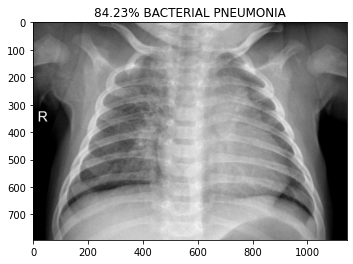

prob:[0.0687446 0.9312554]
BACTERIA/person780_bacteria_2684.jpeg


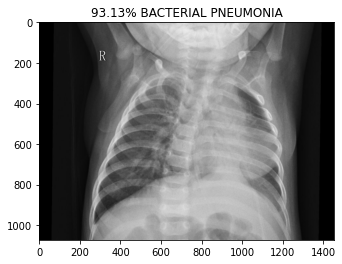

prob:[0.9800331  0.01996688]
BACTERIA/person782_bacteria_2686.jpeg


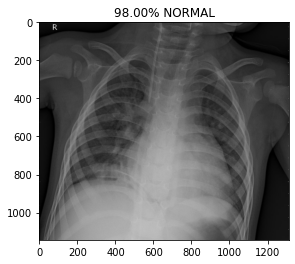

prob:[0.07733629 0.92266375]
BACTERIA/person783_bacteria_2687.jpeg


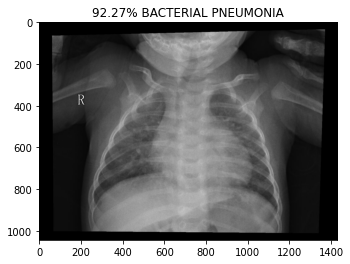

prob:[0.16159219 0.8384078 ]
BACTERIA/person785_bacteria_2689.jpeg


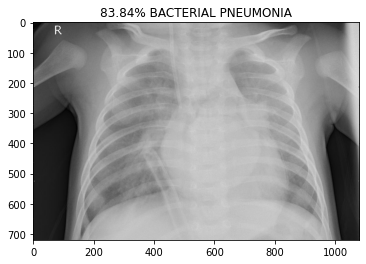

prob:[0.94334525 0.0566548 ]
BACTERIA/person786_bacteria_2690.jpeg


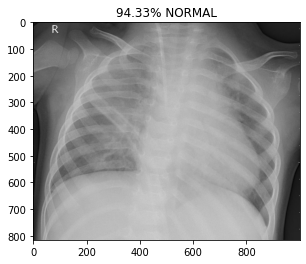

prob:[0.9801775  0.01982255]
BACTERIA/person787_bacteria_2691.jpeg


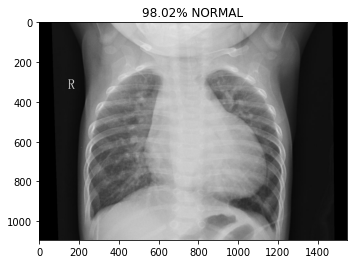

prob:[9.9921584e-01 7.8412739e-04]
BACTERIA/person789_bacteria_2694.jpeg


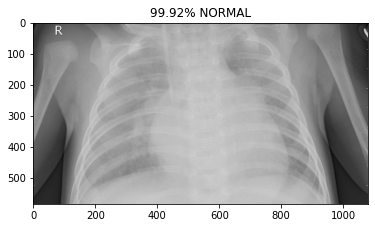

prob:[0.11630387 0.8836961 ]
BACTERIA/person794_bacteria_2700.jpeg


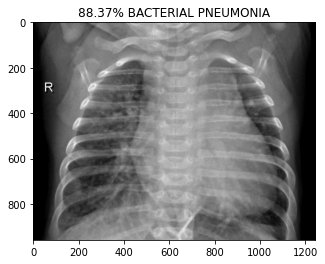

prob:[0.0993439  0.90065604]
BACTERIA/person796_bacteria_2702.jpeg


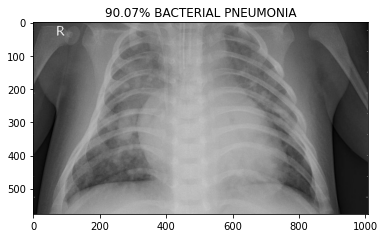

prob:[0.08763799 0.91236204]
BACTERIA/person799_bacteria_2705.jpeg


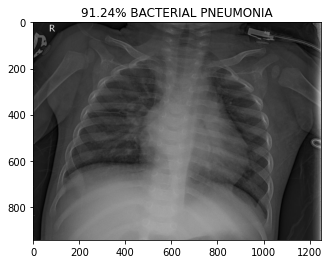

prob:[0.9559826  0.04401734]
BACTERIA/person800_bacteria_2706.jpeg


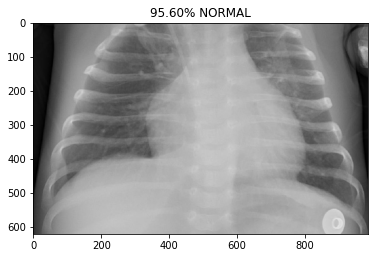

prob:[0.17718282 0.8228172 ]
BACTERIA/person802_bacteria_2708.jpeg


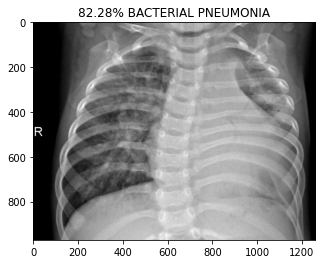

prob:[0.04219263 0.95780736]
BACTERIA/person803_bacteria_2710.jpeg


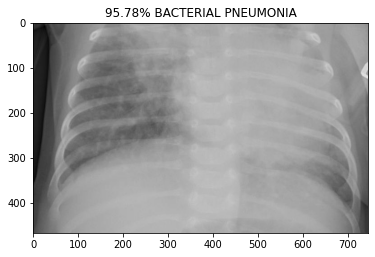

prob:[0.93136096 0.06863903]
BACTERIA/person804_bacteria_2711.jpeg


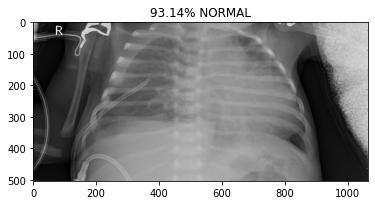

prob:[0.21069263 0.78930736]
BACTERIA/person805_bacteria_2712.jpeg


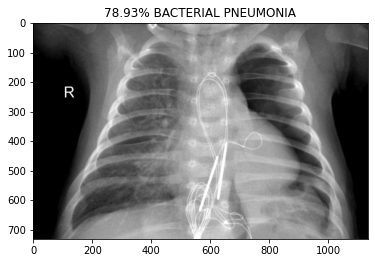

prob:[0.09188518 0.9081148 ]
BACTERIA/person808_bacteria_2716.jpeg


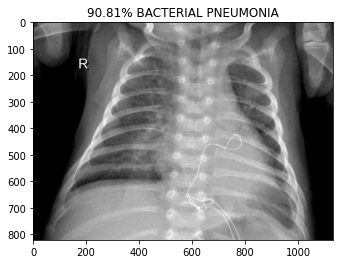

prob:[0.94233215 0.05766787]
BACTERIA/person809_bacteria_2717.jpeg


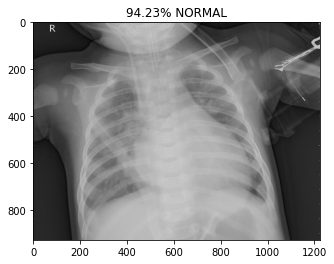

prob:[0.19934092 0.8006591 ]
BACTERIA/person809_bacteria_2718.jpeg


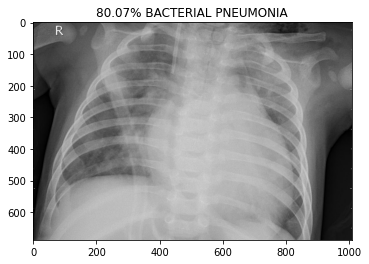

prob:[0.990739   0.00926095]
BACTERIA/person810_bacteria_2719.jpeg


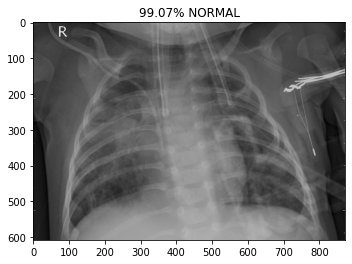

prob:[0.7620487  0.23795132]
BACTERIA/person811_bacteria_2721.jpeg


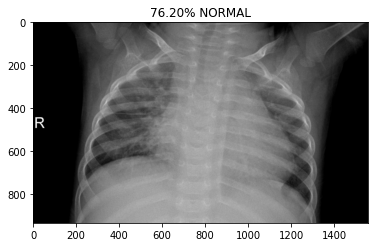

prob:[0.05288795 0.947112  ]
BACTERIA/person813_bacteria_2723.jpeg


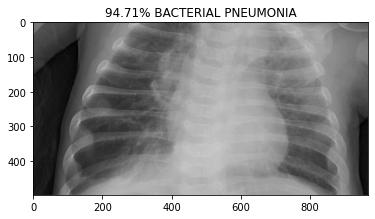

prob:[0.9180583  0.08194175]
BACTERIA/person813_bacteria_2724.jpeg


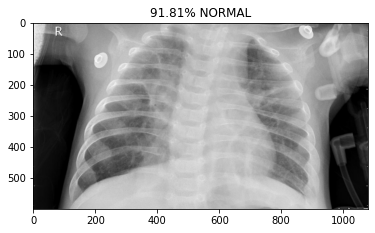

prob:[0.09924678 0.90075326]
BACTERIA/person814_bacteria_2725.jpeg


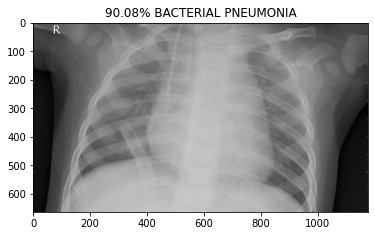

prob:[0.06835295 0.93164706]
BACTERIA/person815_bacteria_2726.jpeg


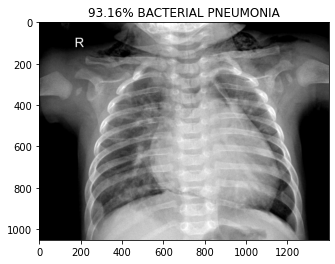

prob:[0.08250799 0.917492  ]
BACTERIA/person816_bacteria_2727.jpeg


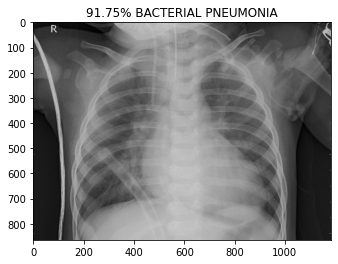

prob:[0.93795866 0.06204138]
BACTERIA/person817_bacteria_2728.jpeg


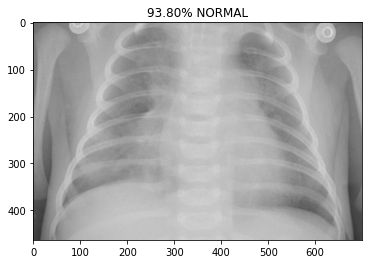

prob:[0.6824737 0.3175263]
BACTERIA/person818_bacteria_2729.jpeg


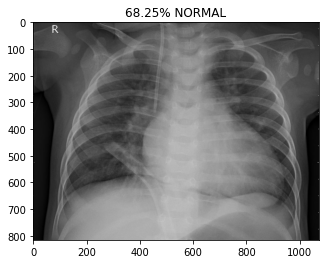

prob:[0.99603623 0.00396382]
BACTERIA/person819_bacteria_2730.jpeg


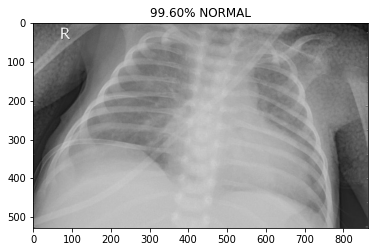

prob:[0.98432213 0.01567783]
BACTERIA/person820_bacteria_2731.jpeg


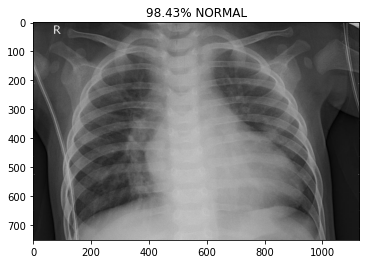

prob:[0.13255715 0.86744285]
BACTERIA/person825_bacteria_2736.jpeg


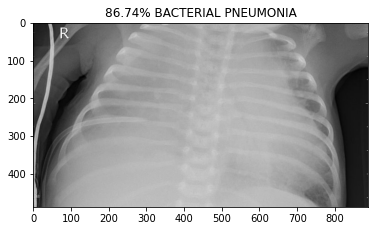

prob:[0.98269975 0.01730023]
BACTERIA/person826_bacteria_2737.jpeg


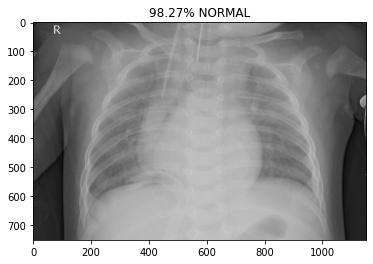

prob:[0.26404393 0.735956  ]
BACTERIA/person827_bacteria_2738.jpeg


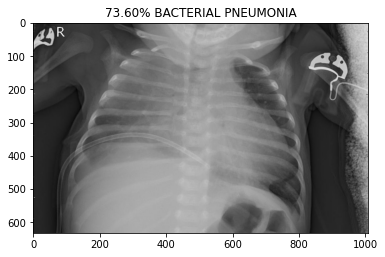

prob:[0.9659087  0.03409135]
BACTERIA/person829_bacteria_2740.jpeg


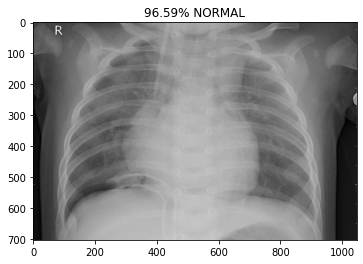

prob:[0.1253565 0.8746435]
BACTERIA/person830_bacteria_2741.jpeg


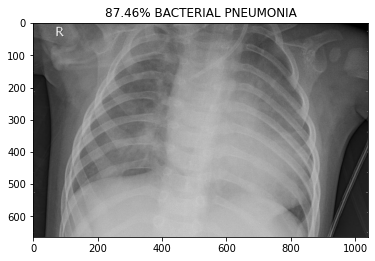

prob:[0.98059845 0.01940152]
BACTERIA/person831_bacteria_2742.jpeg


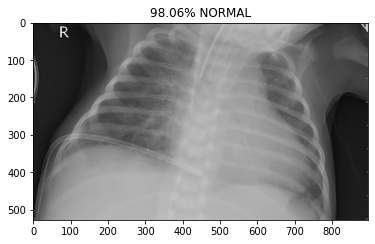

prob:[0.96881527 0.03118473]
BACTERIA/person832_bacteria_2743.jpeg


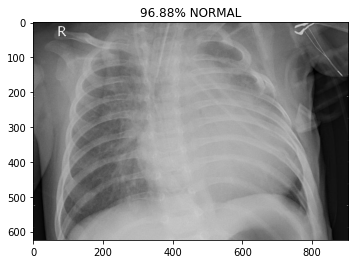

prob:[0.08200006 0.9179999 ]
BACTERIA/person834_bacteria_2747.jpeg


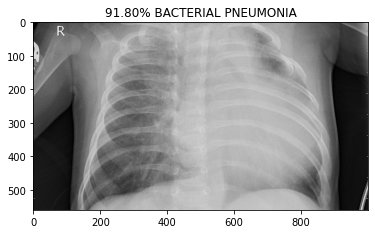

prob:[0.09542235 0.9045776 ]
BACTERIA/person834_bacteria_2748.jpeg


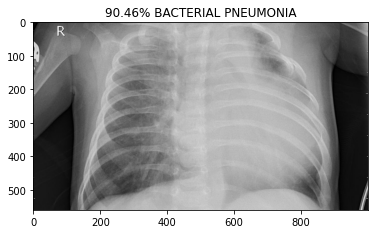

prob:[0.22120525 0.7787947 ]
BACTERIA/person835_bacteria_2749.jpeg


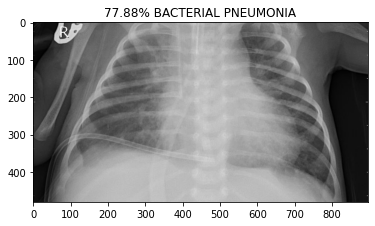

prob:[0.0900935 0.9099065]
BACTERIA/person835_bacteria_2750.jpeg


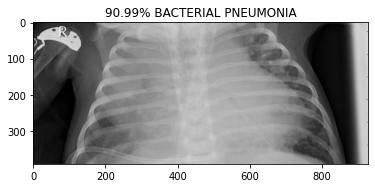

prob:[0.8891989  0.11080113]
BACTERIA/person836_bacteria_2752.jpeg


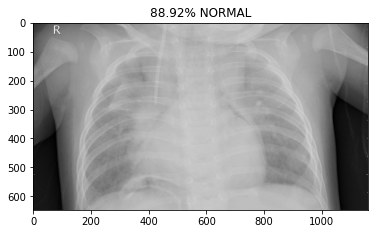

prob:[0.99579006 0.00420991]
BACTERIA/person837_bacteria_2753.jpeg


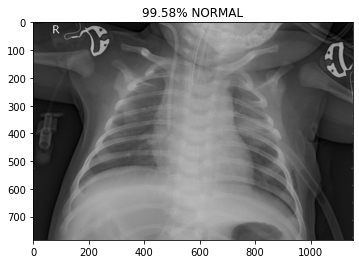

prob:[0.06787588 0.9321241 ]
BACTERIA/person837_bacteria_2754.jpeg


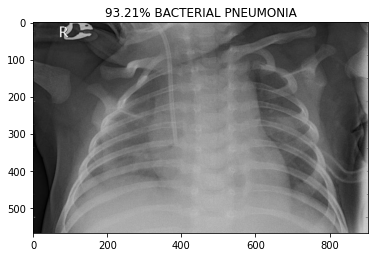

prob:[0.08908329 0.9109167 ]
BACTERIA/person839_bacteria_2757.jpeg


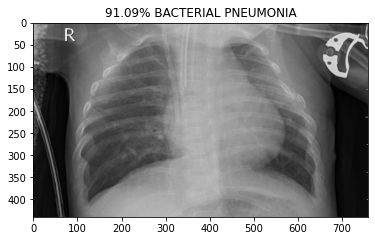

prob:[0.97740114 0.02259886]
BACTERIA/person840_bacteria_2758.jpeg


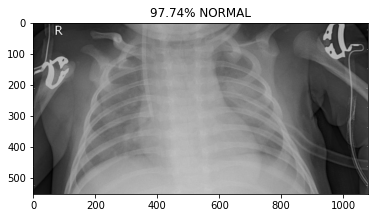

prob:[0.9806615  0.01933844]
BACTERIA/person840_bacteria_2759.jpeg


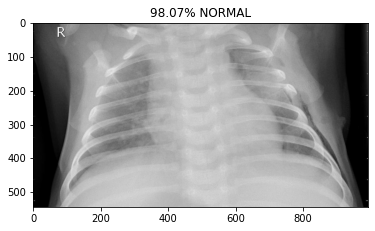

prob:[0.06815623 0.9318437 ]
BACTERIA/person841_bacteria_2760.jpeg


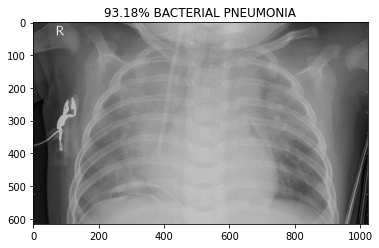

prob:[0.98032266 0.01967739]
BACTERIA/person841_bacteria_2761.jpeg


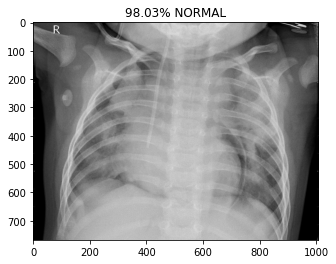

prob:[0.06532432 0.9346757 ]
BACTERIA/person842_bacteria_2762.jpeg


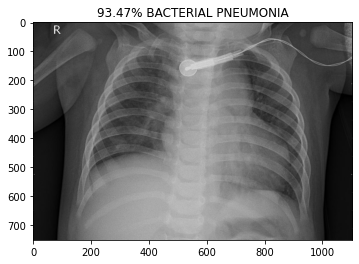

prob:[0.9823173 0.0176826]
BACTERIA/person843_bacteria_2763.jpeg


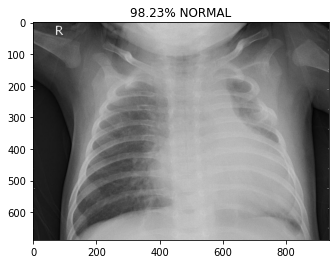

prob:[0.9697119  0.03028813]
BACTERIA/person846_bacteria_2766.jpeg


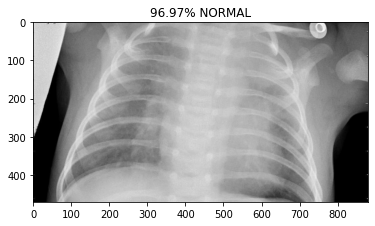

prob:[0.9930346  0.00696536]
BACTERIA/person847_bacteria_2767.jpeg


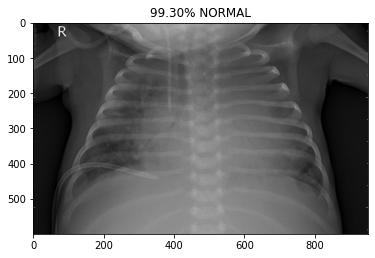

prob:[0.9901543  0.00984571]
BACTERIA/person848_bacteria_2769.jpeg


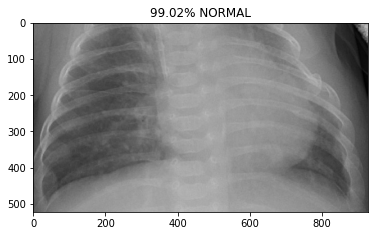

prob:[0.98111373 0.01888629]
BACTERIA/person849_bacteria_2770.jpeg


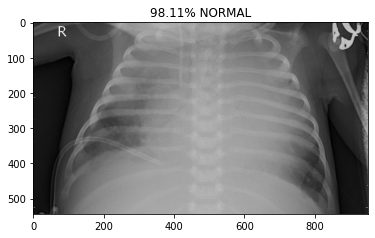

prob:[0.9842807  0.01571935]
BACTERIA/person850_bacteria_2771.jpeg


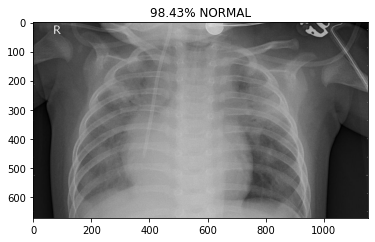

prob:[0.9812843  0.01871569]
BACTERIA/person853_bacteria_2774.jpeg


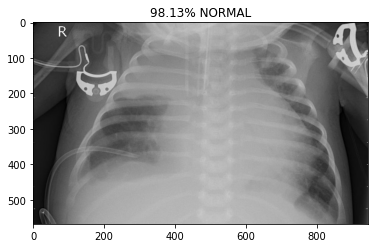

prob:[0.08421824 0.9157818 ]
BACTERIA/person853_bacteria_2775.jpeg


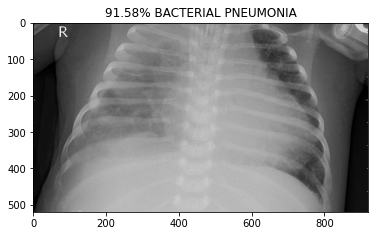

prob:[0.28220466 0.7177954 ]
BACTERIA/person854_bacteria_2776.jpeg


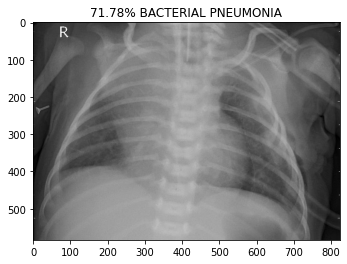

prob:[0.95979464 0.04020534]
BACTERIA/person855_bacteria_2777.jpeg


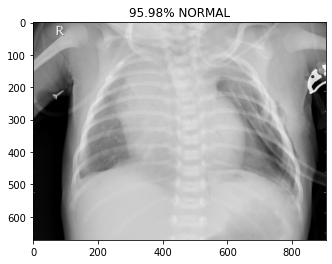

prob:[0.9924901  0.00750989]
BACTERIA/person858_bacteria_2780.jpeg


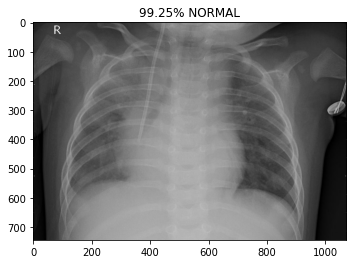

prob:[0.9214902  0.07850979]
BACTERIA/person862_bacteria_2784.jpeg


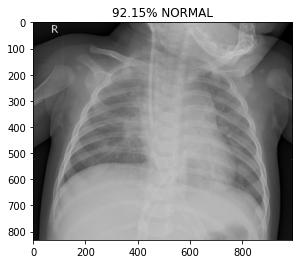

prob:[0.02973626 0.9702637 ]
BACTERIA/person863_bacteria_2785.jpeg


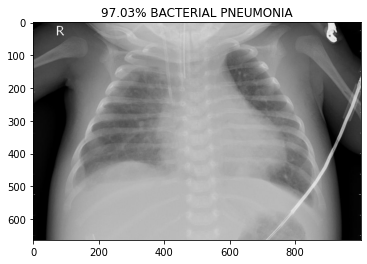

prob:[0.09996786 0.9000321 ]
BACTERIA/person866_bacteria_2788.jpeg


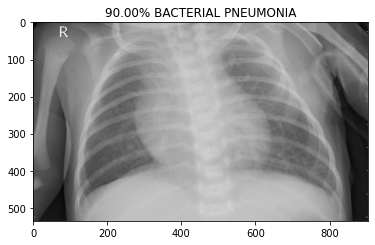

prob:[0.19615565 0.8038444 ]
BACTERIA/person867_bacteria_2789.jpeg


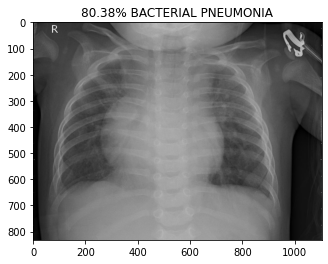

prob:[0.9577003  0.04229974]
BACTERIA/person870_bacteria_2792.jpeg


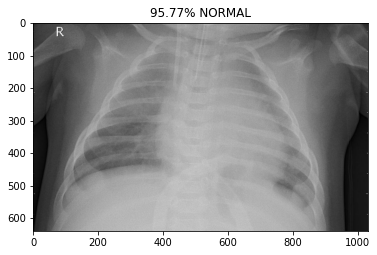

prob:[0.9893764  0.01062363]
BACTERIA/person871_bacteria_2793.jpeg


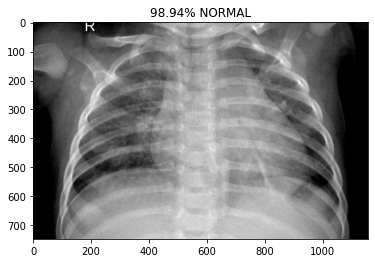

prob:[0.10679485 0.89320517]
BACTERIA/person872_bacteria_2795.jpeg


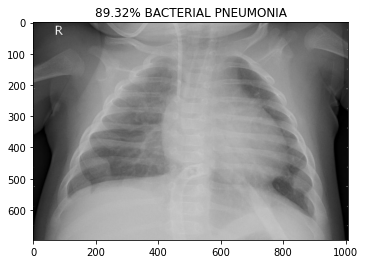

prob:[0.07166098 0.92833906]
BACTERIA/person873_bacteria_2796.jpeg


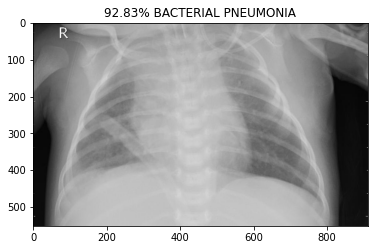

prob:[0.9815403  0.01845963]
BACTERIA/person874_bacteria_2797.jpeg


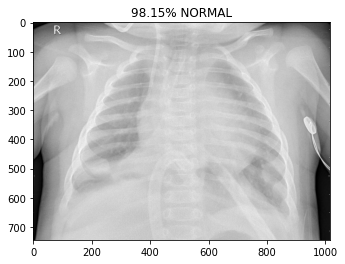

prob:[0.252362 0.747638]
BACTERIA/person875_bacteria_2798.jpeg


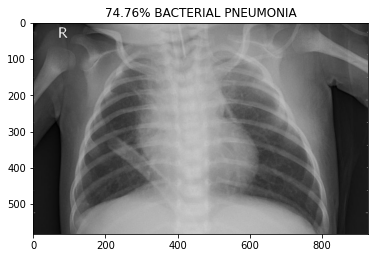

prob:[0.06989786 0.93010217]
BACTERIA/person876_bacteria_2799.jpeg


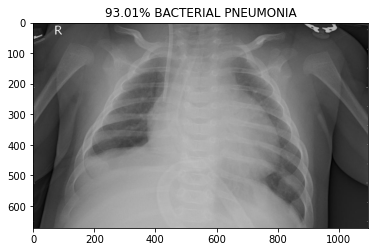

prob:[0.9471194  0.05288067]
BACTERIA/person877_bacteria_2800.jpeg


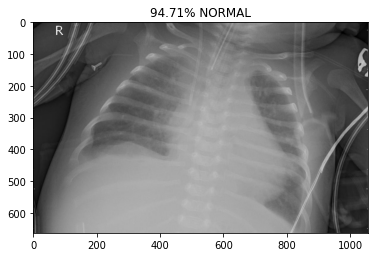

prob:[0.04525725 0.9547428 ]
BACTERIA/person878_bacteria_2801.jpeg


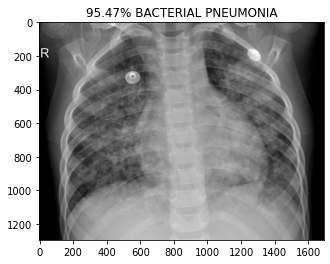

prob:[0.07523009 0.9247699 ]
BACTERIA/person880_bacteria_2804.jpeg


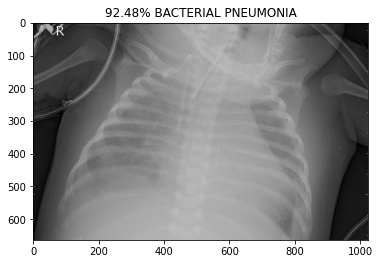

prob:[0.28691834 0.7130816 ]
BACTERIA/person881_bacteria_2805.jpeg


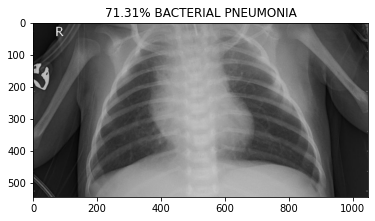

prob:[0.9793465 0.0206535]
BACTERIA/person882_bacteria_2806.jpeg


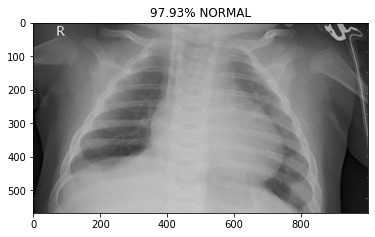

prob:[0.05447736 0.94552267]
BACTERIA/person883_bacteria_2807.jpeg


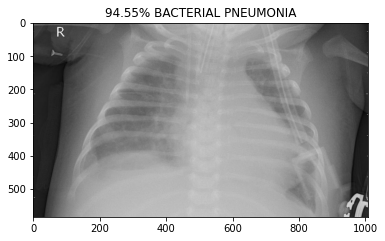

prob:[0.05593925 0.9440608 ]
BACTERIA/person884_bacteria_2808.jpeg


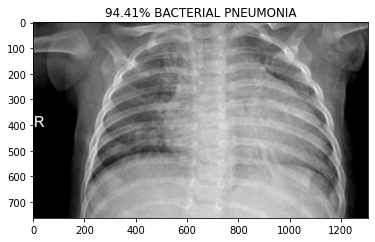

prob:[0.9855542  0.01444579]
BACTERIA/person885_bacteria_2809.jpeg


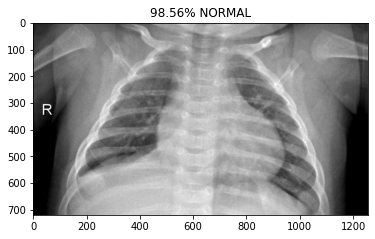

prob:[0.04512652 0.95487344]
BACTERIA/person886_bacteria_2810.jpeg


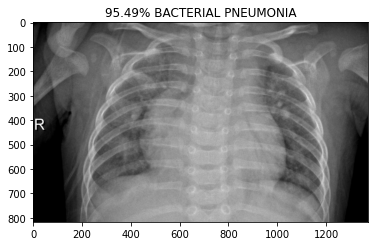

prob:[0.15019165 0.8498084 ]
BACTERIA/person887_bacteria_2811.jpeg


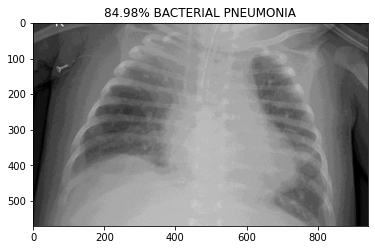

prob:[0.9440236  0.05597639]
BACTERIA/person888_bacteria_2812.jpeg


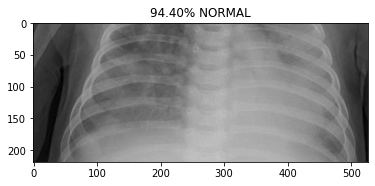

prob:[0.98893726 0.01106272]
BACTERIA/person889_bacteria_2813.jpeg


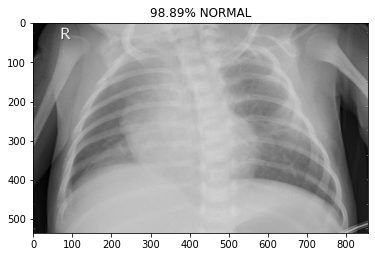

prob:[0.94031274 0.05968729]
BACTERIA/person890_bacteria_2814.jpeg


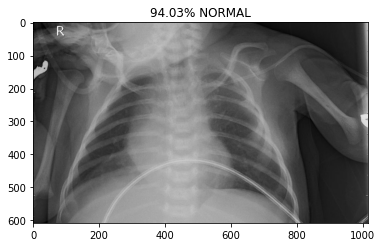

prob:[0.8176224 0.1823776]
BACTERIA/person892_bacteria_2817.jpeg


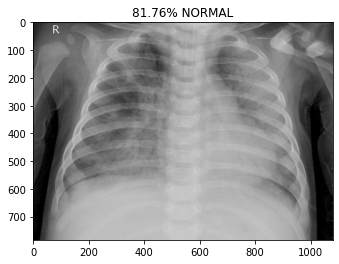

prob:[0.03645517 0.96354485]
BACTERIA/person893_bacteria_2818.jpeg


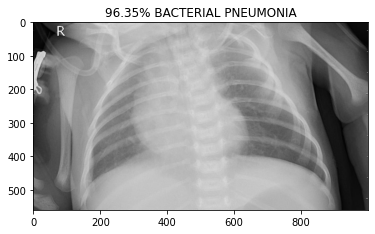

prob:[0.03935137 0.96064866]
BACTERIA/person894_bacteria_2819.jpeg


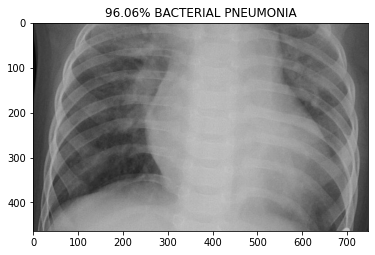

prob:[0.09594161 0.9040584 ]
BACTERIA/person895_bacteria_2820.jpeg


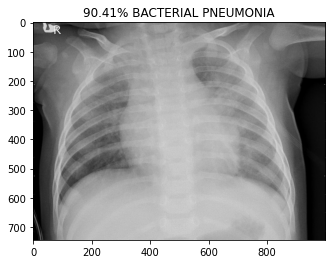

prob:[0.13710362 0.86289644]
BACTERIA/person896_bacteria_2821.jpeg


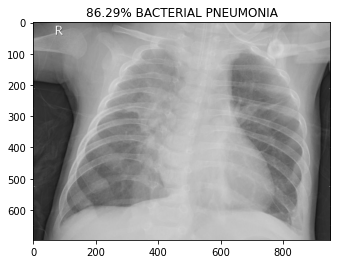

prob:[0.9944153  0.00558473]
BACTERIA/person897_bacteria_2822.jpeg


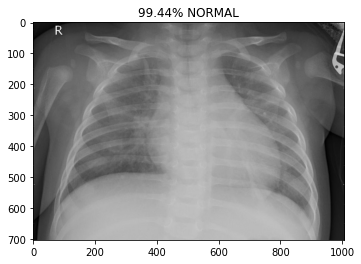

prob:[0.9907776  0.00922237]
BACTERIA/person898_bacteria_2823.jpeg


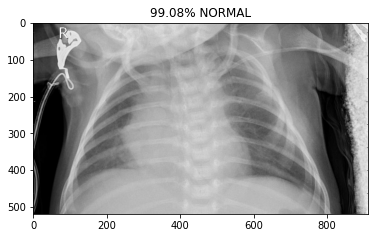

prob:[0.9906844 0.0093156]
BACTERIA/person902_bacteria_2827.jpeg


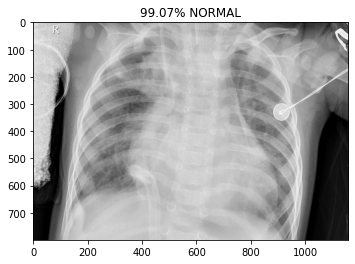

prob:[0.1221731 0.8778269]
BACTERIA/person903_bacteria_2828.jpeg


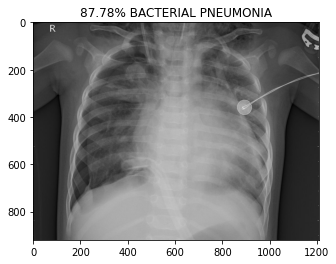

prob:[0.5809987 0.4190013]
BACTERIA/person904_bacteria_2829.jpeg


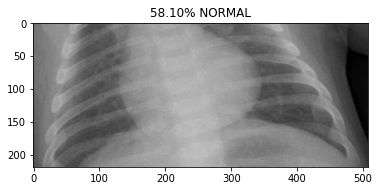

prob:[0.06202694 0.937973  ]
BACTERIA/person905_bacteria_2830.jpeg


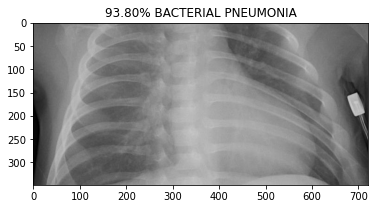

prob:[0.9942181  0.00578186]
BACTERIA/person906_bacteria_2831.jpeg


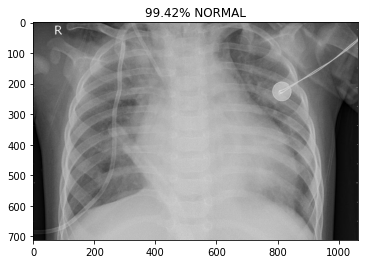

prob:[0.97857684 0.02142314]
BACTERIA/person907_bacteria_2832.jpeg


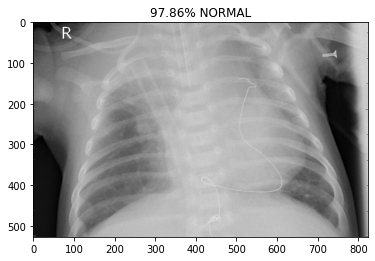

prob:[0.08241752 0.9175825 ]
BACTERIA/person909_bacteria_2834.jpeg


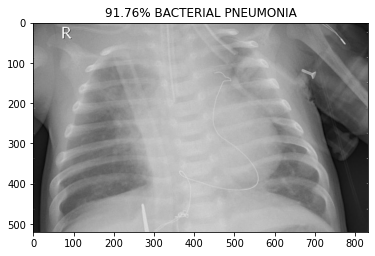

prob:[0.14225791 0.85774213]
BACTERIA/person911_bacteria_2836.jpeg


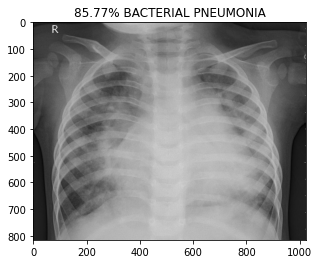

prob:[0.0753778 0.9246222]
BACTERIA/person912_bacteria_2837.jpeg


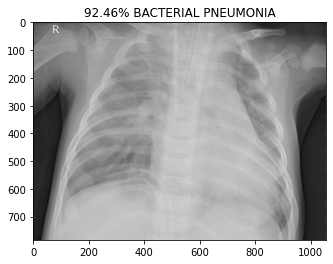

prob:[0.9404577  0.05954235]
BACTERIA/person913_bacteria_2838.jpeg


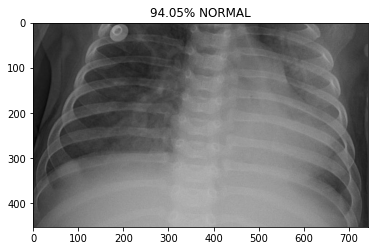

prob:[0.9405475  0.05945249]
BACTERIA/person914_bacteria_2839.jpeg


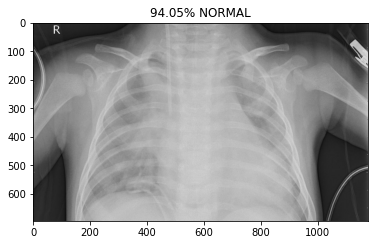

prob:[0.9693375  0.03066253]
BACTERIA/person916_bacteria_2841.jpeg


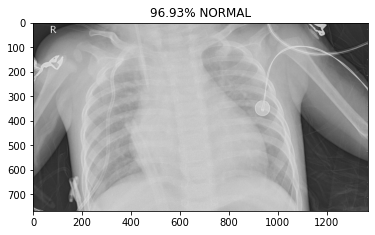

prob:[0.8941126  0.10588747]
BACTERIA/person917_bacteria_2842.jpeg


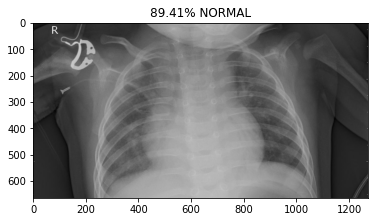

prob:[0.1120824  0.88791764]
BACTERIA/person918_bacteria_2843.jpeg


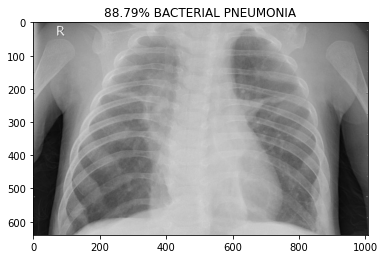

prob:[0.963025   0.03697508]
BACTERIA/person919_bacteria_2844.jpeg


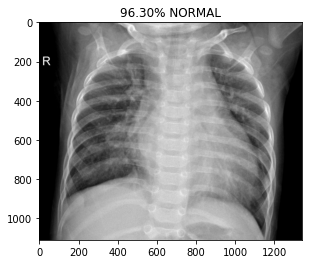

In [ ]:
pred = model.predict_generator(test_set,10,verbose=1)
print("Predictions finished")
import cv2
import matplotlib.image as mpimg
for index, probability in enumerate(pred):
 image_path = valid + "/" +test_set.filenames[index]
 image = mpimg.imread(image_path)
 #BGR TO RGB conversion using CV2
 image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
 pixels = np.array(image)
 plt.imshow(pixels)
 print("prob:{}".format(probability))
 print(test_set.filenames[index])
 if probability[1] > 0.5:
     plt.title('%.2f' % (probability[1]*100) + '% BACTERIAL PNEUMONIA')
 else:
     plt.title('%.2f' % ((1-probability[1])*100) + '% NORMAL')
 plt.show()

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix,plot_confusion_matrix
Y_pred = model.predict_generator(test_set)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/engine/training.py:2001: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  warnings.warn('`Model.predict_generator` is deprecated and '


In [ ]:
Y_pred = np.argmax(test_set, axis=1)

NameError: ignored

In [ ]:
import itertools
def plot_confusion_matrix(cm, classes,
    normalize=False,
    title='Confusion matrix',
    cmap=plt.cm.Blues):
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)
    

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.show()

In [ ]:
cm = confusion_matrix(y_true=test_set.classes, y_pred=y_pred)
cm_plot_labels= ['Bacterial Pneumonia','Normal']

In [ ]:
plot_confusion_matrix(cm=cm, classes=cm_plot_labels, title='Confusion Matrix')

In [ ]:
#model.compile(loss=tf.keras.losses.Categorical_Crossentropy(from_logits=False),
            #  optimizer = tf.keras.optimizers.Adam,
         #     metrics=['accuracy'])

FOLLOWING CODE IS UNDER PROGRESS FOR FINE TUNING

In [ ]:
for i in range (len(res.layers)):
    print (i,res.layers[i])

In [ ]:
#for layer in res.layers[159:176]:
 #   layer.trainable=True
#for layer in res.layers[0:159]:
 # layer.trainable = False

In [ ]:
#model.save('saved_models/new1.h5') done once

In [ ]:
model.compile(
  loss='categorical_crossentropy',
  optimizer=Adam(learning_rate=0.001,decay=((1e-6)/60)),
  metrics=['accuracy']
)

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='loss', factor=0.2,
                              patience=2, min_lr=0.0001, verbose=1, cooldown=3, mode='auto')

In [ ]:
tune_epochs = 60
total_epochs = tune_epochs + 25
history_fine = model.fit_generator(training_set,
                         epochs=total_epochs,
                         initial_epoch=history.epoch[-1],
                         validation_data=test_set)

In [ ]:
plt.plot(history_fine.history['accuracy'])
plt.plot(history_fine.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epochs')
plt.ylim(0.5,1)
plt.legend(['train', 'test'])
plt.show()

In [ ]:
plt.plot(history_fine.history['loss'])
plt.plot(history_fine.history['val_loss'])
plt.title('Model Loss After Finetuning')
plt.ylabel('Loss')
plt.xlabel('Epochs')
plt.ylim(0,0.5)
plt.legend(['train', 'test'])
plt.show()

In [ ]:
!mkdir -p saved_model

In [ ]:
model.save('saved_models/post_tuning.h5')

In [ ]:
test_model=tf.keras.models.load_model('saved_model/Bact.h5')

In [ ]:
test_images='val/BACTERIA/1.jpeg'
test_images